# Remaking Figure 4 of the Brick Ice Paper

In [147]:
from glob import glob
from astroquery.mast import Mast, Observations
import os
import shutil
import pyavm
import numpy as np
import PIL
import json
import requests
import asdf
import regions
from astropy import log
from astropy.io import ascii, fits
from astropy.wcs import WCS
from astropy import wcs
from astropy.coordinates import SkyCoord
from astropy.utils.data import download_file
from astropy.visualization import ImageNormalize, ManualInterval, LogStretch, LinearStretch
from astropy.visualization import simple_norm
import matplotlib.pyplot as plt
import matplotlib as mpl
from astropy.table import Table
from astropy.nddata import Cutout2D
import astropy.units as u

# do this before importing webb
os.environ["CRDS_PATH"] = "/orange/adamginsburg/jwst/brick/crds/"
os.environ["CRDS_SERVER_URL"] = "https://jwst-crds.stsci.edu"
from jwst.datamodels import ImageModel

from jwst.pipeline import calwebb_image3
from jwst.pipeline import Detector1Pipeline, Image2Pipeline

from jwst.datamodels import ImageModel

import jwst.datamodels
from jwst import datamodels

In [148]:
filename_B = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
fits.getheader(filename_B)

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -64 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                 6521                                                  
NAXIS2  =                16577                                                  
WCSAXES =                    2 / Number of coordinate axes                      
CRPIX1  =      3263.1107489706 / Pixel coordinate of reference point            
CRPIX2  =      8283.3559284205 / Pixel coordinate of reference point            
CDELT1  = -8.6768754638239E-06 / [deg] Coordinate increment at reference point  
CDELT2  =  8.6768754638239E-06 / [deg] Coordinate increment at reference point  
CUNIT1  = 'deg'                / Units of coordinate increment and value        
CUNIT2  = 'deg'                / Units of coordinate increment and value        
CTYPE1  = 'RA---TAN'        

In [149]:
basepath = '/orange/adamginsburg/jwst/cloudc/'

In [150]:
cd /orange/adamginsburg/jwst/cloudc/analysis/

/blue/adamginsburg/adamginsburg/jwst/cloudc/code/brick-jwst-2221/analysis


In [151]:
import plot_tools

In [152]:
import matplotlib as mpl
import pylab as pl
import numpy as np

def multidigitize(x,y,binsx,binsy):
    dx = np.digitize(x.flat, binsx)
    dy = np.digitize(y.flat, binsy)
    return dx,dy

def linlogspace(xmin,xmax,n):
    return np.logspace(np.log10(xmin),np.log10(xmax),n)

def adaptive_param_plot(x,y,
                        bins=10,
                        threshold=5,
                        marker='.',
                        marker_color=None,
                        ncontours=5,
                        levels=None,
                        fill=False,
                        mesh=False,
                        contourspacing=linlogspace,
                        mesh_alpha=0.5,
                        norm=None,
                        axis=None,
                        cmap=None,
                        percentilelevels=None,
                        **kwargs):
    """
    Plot contours where the density of data points to be plotted is too high

    Many of these parameters are just passed on to matplotlib's "plot" and
    "contour" functions

    Parameters
    ----------
    bins: int or ndarray
        The number of bins or a list of bins.  Passed to np.histogram2d; see
        their docs for details
    threshold: int
        The minimum number of points to replace a bin with a contour.  For
        npoints<=threshold, the individual points will be plotted
    marker: str
        Any valid marker (see matplotlib.plot)
    marker_color: str
        Any valid marker color
    ncontours: int
        Number of contour levels
    levels: None or list 
        Optional override for automatically computed levels
    fill: bool
        Use filled contours?
    mesh: bool
        Use a color mesh instead of contours (i.e., filled pixels)
    contourspacing: function
        A function to determine the contour spacing.  Should be 
        np.linspace or the linlogspace function
        defined above.  The function must accept arguments of:
        lowest contour level, highest contour level, number of contours
    mesh_alpha: float
        Alpha opacity parameter of the colormesh, if used
    norm: matplotlib.colors.Normalize
        A normalization to use for the contours or colormesh
    axis: None or matplotlib.Axes
        A matplotlib axis to plot on
    cmap: matplotlib colormap
        A valid matplotlib color map
    kwargs: dict
        Passed to plot, contour, AND colormesh, so must be valid for ALL 3!
    """
    
    if axis is None:
        axis = pl.gca()

    ok = np.isfinite(x) * np.isfinite(y)

    # set the number of bins to be an integer value, which can be extracted
    # from an array-style bin set
    if hasattr(bins,'ndim') and bins.ndim == 2:
        # If you define the bins as an array, they define the BIN EDGES, so nbins=len(bins)-1
        nbinsx,nbinsy = bins.shape[1]-1,bins.shape[1]-1
    else:
        try:
            nbinsx = nbinsy = len(bins)-1
        except TypeError:
            nbinsx = nbinsy = bins

    H,bx,by = np.histogram2d(x[ok],y[ok],bins=bins)

    # determine the locations of each pixel
    dx,dy = multidigitize(x[ok],y[ok],bx,by)

    # anything beyond the range of the histogram bins defaults to plottable=True
    # need +1 because anything <bins.min() or >bins.max() is on the edges...
    plottable = np.ones([nbinsx+2,nbinsy+2], dtype='bool')
    # Need a cropped version of "plottable" to index H
    # This is a view on plottable, so should result in inplace modification...
    # (this version does not include the points > bins.max() and < bins.min(),
    # which will all be plotted)
    plottable_hist = plottable[1:-1,1:-1]
    assert H.shape == plottable_hist.shape
    # points are plottable if below the threshold
    plottable_hist[H > threshold] = False

    #H[plottable] = np.nan
    H[plottable_hist] = 0
    #H = np.ma.masked_where(plottable,H)
    toplot = plottable[dx,dy]

    cx = (bx[1:]+bx[:-1])/2.
    cy = (by[1:]+by[:-1])/2.
    if levels is None:
        if percentilelevels is not None:
            sortedH = np.sort(H.flat)
            cumfrac = np.cumsum(sortedH) / H.sum()
            levels = [sortedH[np.argmin(np.abs(cumfrac - plev))] for plev in percentilelevels]
        else:
            levels = contourspacing(threshold-0.5,H.max(),ncontours)
    #levels = contourspacing(0,H.max(),ncontours)

    if cmap is None:
        cmap = mpl.cm.get_cmap()
        cmap.set_under((0,0,0,0))
        cmap.set_bad((0,0,0,0))

    if fill:
        con = axis.contourf(cx,cy,H.T,levels=levels,norm=norm,cmap=cmap,**kwargs)
    else:
        con = axis.contour(cx,cy,H.T,levels=levels,norm=norm,cmap=cmap,**kwargs)
    if mesh:
        mesh = axis.pcolormesh(bx,by,H.T, **kwargs)
        mesh.set_alpha(mesh_alpha)
    
    if 'linestyle' in kwargs:
        kwargs.pop('linestyle')

    if marker not in ('none', None):
        axis.plot(x[ok][toplot],
                  y[ok][toplot],
                  linestyle='none',
                  marker=marker,
                  markerfacecolor=marker_color,
                  markeredgecolor=marker_color,
                  **kwargs)

    return cx,cy,H,x[ok][toplot],y[ok][toplot]

In [153]:
#%run selections.py

In [154]:
basetable = Table.read(f'{basepath}/catalogs/basic_merged_photometry_tables_merged.fits')
#basetable = Table.read(f'{basepath}/catalogs/crowdsource_nsky0_merged_photometry_tables_merged.fits')
#basetable = Table.read('/orange/adamginsburg/jwst/cloudc/catalogs/test_notebook.fits')

In [155]:
crds = basetable['skycoord_ref']

In [156]:
ls /orange/adamginsburg/jwst/cloudc/images/*merged_i2d.fits

/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f182m-merged_i2d.fits
/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f187n-merged_i2d.fits
/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f212n-merged_i2d.fits
/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f405n-merged_i2d.fits
/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f410m-merged_i2d.fits
/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f466n-merged_i2d.fits


In [157]:
#data = fits.getdata('/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f405n-merged_i2d.fits')
#head = fits.getheader('/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f405n-merged_i2d.fits')
#ww = WCS(head)

im = ImageModel('/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f405n-merged_i2d.fits')
data = im.data
ww = im.get_fits_wcs()

2024-06-18 12:55:10,414 - stpipe - WARNING - /blue/adamginsburg/adamginsburg/repos/astropy/astropy/wcs/wcs.py:807: FITSFixedWarning: 'datfix' made the change 'Set DATE-BEG to '2023-04-15T15:08:19.262' from MJD-BEG.
Set DATE-AVG to '2023-04-20T10:07:44.724' from MJD-AVG.
Set DATE-END to '2023-04-25T05:06:53.406' from MJD-END'.
  warnings.warn(

2024-06-18 12:55:10,419 - stpipe - WARNING - /blue/adamginsburg/adamginsburg/repos/astropy/astropy/wcs/wcs.py:807: FITSFixedWarning: 'obsfix' made the change 'Set OBSGEO-L to  -134.380275 from OBSGEO-[XYZ].
Set OBSGEO-B to    -3.177752 from OBSGEO-[XYZ].
Set OBSGEO-H to 1298809712.873 from OBSGEO-[XYZ]'.
  warnings.warn(



### Helper Functions

In [158]:
def get_cutout(filename, position, l, w):
    try: 
        hdu = fits.open(filename, ext='SCI')[0]
    except: 
        hdu = fits.open(filename)[0]
    data = hdu.data
    head = hdu.header

    #pixel_scale = head['PIXSCALE']*u.arcsec/u.pix
    ww = WCS(head)
    size = (l, w)
    #((l/pixel_scale).to(u.pix), (w/pixel_scale).to(u.pix))
    cutout = Cutout2D(data, position=position, size=size, wcs=ww)
    return cutout

def get_cutout_405(position, l, w):
    fn = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    return get_cutout(fn, position, l, w)
    
def get_cutout_410(position, l, w):
    fn = '/orange/adamginsburg/jwst/cloudc/images/F410_reproj_merged-fortricolor.fits'
    return get_cutout(fn, position, l, w)

def get_cutout_466(position, l, w):
    fn = '/orange/adamginsburg/jwst/cloudc/images/F466_reproj_merged-fortricolor.fits'
    return get_cutout(fn, position, l, w)

def get_cutout_187(position, l, w):
    fn = '/orange/adamginsburg/jwst/cloudc/images/F187_reproj_merged-fortricolor.fits'
    return get_cutout(fn, position, l, w)
    
def get_cutout_182(position, l, w):
    fn = '/orange/adamginsburg/jwst/cloudc/images/F182_reproj_merged-fortricolor.fits'
    return get_cutout(fn, position, l, w)

def get_cutout_212(position, l, w):
    fn = '/orange/adamginsburg/jwst/cloudc/images/F212_reproj_merged-fortricolor.fits'
    return get_cutout(fn, position, l, w)

def get_cutout_rgb(position, l, w):
    #filename_R = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    filename_R = '/orange/adamginsburg/jwst/cloudc/images/F466_reproj_merged-fortricolor.fits'
    #filename_B = '/orange/adamginsburg/jwst/cloudc/images/F187_reproj_merged-fortricolor.fits'
    filename_B = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    cutout_R = get_cutout(filename_R, position, l, w)
    cutout_B = get_cutout(filename_B, position, l, w)
    cutout_G = cutout_R.data + cutout_B.data
    rgb = np.array(
        [
            cutout_R.data,
            cutout_G,
            cutout_B.data
        ]
    ).swapaxes(0,2).swapaxes(0,1)
    rgb_scaled = np.array([
        simple_norm(rgb[:,:,0], stretch='asinh', min_cut=-1, max_cut=90)(rgb[:,:,0]),
        simple_norm(rgb[:,:,1], stretch='asinh', min_cut=-2, max_cut=210)(rgb[:,:,1]),
        simple_norm(rgb[:,:,2], stretch='asinh', min_cut=-1, max_cut=120)(rgb[:,:,2]),
    ]).swapaxes(0,2)
    return rgb_scaled.swapaxes(0,1), cutout_R.wcs

def get_cutout_rgb_br(position, l, w):
    #filename_R = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    filename_R = '/orange/adamginsburg/jwst/cloudc/images/F410_reproj_merged-fortricolor.fits'
    #filename_B = '/orange/adamginsburg/jwst/cloudc/images/F187_reproj_merged-fortricolor.fits'
    filename_B = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    cutout_R = get_cutout(filename_R, position, l, w)
    cutout_B = get_cutout(filename_B, position, l, w)
    cutout_G = cutout_R.data + cutout_B.data
    rgb = np.array(
        [
            cutout_R.data,
            cutout_G,
            cutout_B.data
        ]
    ).swapaxes(0,2).swapaxes(0,1)
    rgb_scaled = np.array([
        simple_norm(rgb[:,:,0], stretch='asinh', min_cut=-1, max_cut=90)(rgb[:,:,0]),
        simple_norm(rgb[:,:,1], stretch='asinh', min_cut=-2, max_cut=210)(rgb[:,:,1]),
        simple_norm(rgb[:,:,2], stretch='asinh', min_cut=-1, max_cut=120)(rgb[:,:,2]),
    ]).swapaxes(0,2)
    return rgb_scaled.swapaxes(0,1), cutout_R.wcs

def get_cutout_rgb_short(position, l, w):
    #filename_R = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    filename_R = '/orange/adamginsburg/jwst/cloudc/images/F212_reproj_merged-fortricolor.fits'
    #filename_B = '/orange/adamginsburg/jwst/cloudc/images/F187_reproj_merged-fortricolor.fits'
    filename_B = '/orange/adamginsburg/jwst/cloudc/images/F187_reproj_merged-fortricolor.fits'
    cutout_R = get_cutout(filename_R, position, l, w)
    cutout_B = get_cutout(filename_B, position, l, w)
    cutout_G = cutout_R.data + cutout_B.data
    rgb = np.array(
        [
            cutout_R.data,
            cutout_G,
            cutout_B.data
        ]
    ).swapaxes(0,2).swapaxes(0,1)
    rgb_scaled = np.array([
        simple_norm(rgb[:,:,0], stretch='asinh', min_cut=-1, max_cut=90)(rgb[:,:,0]),
        simple_norm(rgb[:,:,1], stretch='asinh', min_cut=-2, max_cut=210)(rgb[:,:,1]),
        simple_norm(rgb[:,:,2], stretch='asinh', min_cut=-1, max_cut=120)(rgb[:,:,2]),
    ]).swapaxes(0,2)
    return rgb_scaled.swapaxes(0,1), cutout_R.wcs

def get_cutout_rgb_alt(position, l, w):
    filename_R = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    #filename_R = '/orange/adamginsburg/jwst/cloudc/images/F466_reproj_merged-fortricolor.fits'
    filename_B = '/orange/adamginsburg/jwst/cloudc/images/F187_reproj_merged-fortricolor.fits'
    #filename_B = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    cutout_R = get_cutout(filename_R, position, l, w)
    cutout_B = get_cutout(filename_B, position, l, w)
    cutout_G = cutout_R.data + cutout_B.data
    rgb = np.array(
        [
            cutout_R.data,
            cutout_G,
            cutout_B.data
        ]
    ).swapaxes(0,2).swapaxes(0,1)
    rgb_scaled = np.array([
        simple_norm(rgb[:,:,0], stretch='asinh', min_cut=-1, max_cut=90)(rgb[:,:,0]),
        simple_norm(rgb[:,:,1], stretch='asinh', min_cut=-2, max_cut=210)(rgb[:,:,1]),
        simple_norm(rgb[:,:,2], stretch='asinh', min_cut=-1, max_cut=120)(rgb[:,:,2]),
    ]).swapaxes(0,2)
    return rgb_scaled.swapaxes(0,1), cutout_R.wcs
 
#crds_in = crds_ab[reg.contains(crds_ab, wcs=ww_1)]

# NIRCam Basetable

## Scatter Plot

In [159]:
mas_405 = np.logical_or(np.array(basetable['qfit_f405n'])<0.4, np.isnan(np.array(basetable['mag_ab_f405n'])))
mas_410 = np.logical_or(np.array(basetable['qfit_f410m'])<0.4, np.isnan(np.array(basetable['mag_ab_f410m'])))
mask = np.logical_and(mas_405, mas_410)
mas_466 = np.logical_or(np.array(basetable['qfit_f466n'])<0.4, np.isnan(np.array(basetable['mag_ab_f466n'])))
mask = np.logical_and(mask, mas_466)
mas_187 = np.logical_or(np.array(basetable['qfit_f187n'])<0.4, np.isnan(np.array(basetable['mag_ab_f187n'])))
mask = np.logical_and(mask, mas_187)
mas_182 = np.logical_or(np.array(basetable['qfit_f182m'])<0.4, np.isnan(np.array(basetable['mag_ab_f182m'])))
mask = np.logical_and(mask, mas_182)
mas_212 = np.logical_or(np.array(basetable['qfit_f212n'])<0.4, np.isnan(np.array(basetable['mag_ab_f212n'])))
mask = np.logical_and(mask, mas_212)

In [160]:
tbl_use = basetable[mask]
crds_use = tbl_use['skycoord_ref']

#tbl_other = basetable[mask_noshort_yeslong]
#crds_other = tbl_other['skycoord_ref']

In [161]:
len(tbl_use) # masked catalog qfit < 0.4

334005

In [162]:
len(basetable)

993502

In [163]:
nandata = data*np.nan

### Exploring Quality Factors - Daophot

In [88]:
basetable.columns

<TableColumns names=('skycoord_ref','skycoord_ref_filtername','sep_f410m','id_f410m_1','skycoord_centroid_f410m','skycoord_f410m','id_f410m_2','group_id_f410m','local_bkg_f410m','x_init_f410m','y_init_f410m','flux_init_f410m','x_fit_f410m','y_fit_f410m','flux_f410m','x_err_f410m','y_err_f410m','flux_err_f410m','npixfit_f410m','group_size_f410m','qfit_f410m','cfit_f410m','flags_f410m','mask_f410m','flux_jy_f410m','mag_ab_f410m','eflux_jy_f410m','emag_ab_f410m','near_saturated_f410m_f410m','replaced_saturated_f410m','sep_f212n','id_f212n_1','skycoord_centroid_f212n','skycoord_f212n','id_f212n_2','group_id_f212n','local_bkg_f212n','x_init_f212n','y_init_f212n','flux_init_f212n','x_fit_f212n','y_fit_f212n','flux_f212n','x_err_f212n','y_err_f212n','flux_err_f212n','npixfit_f212n','group_size_f212n','qfit_f212n','cfit_f212n','flags_f212n','mask_f212n','flux_jy_f212n','mag_ab_f212n','eflux_jy_f212n','emag_ab_f212n','near_saturated_f212n_f212n','replaced_saturated_f212n','sep_f466n','id_f466n_

In [158]:
qf_405 = basetable['qfit_f405n']
qf_405_m = basetable['qfit_f405n'] < 0.5
cf_405 = basetable['cfit_f405n']

In [142]:
len(basetable[qf_405_m])

212063

Text(0, 0.5, 'qfit_f405n')

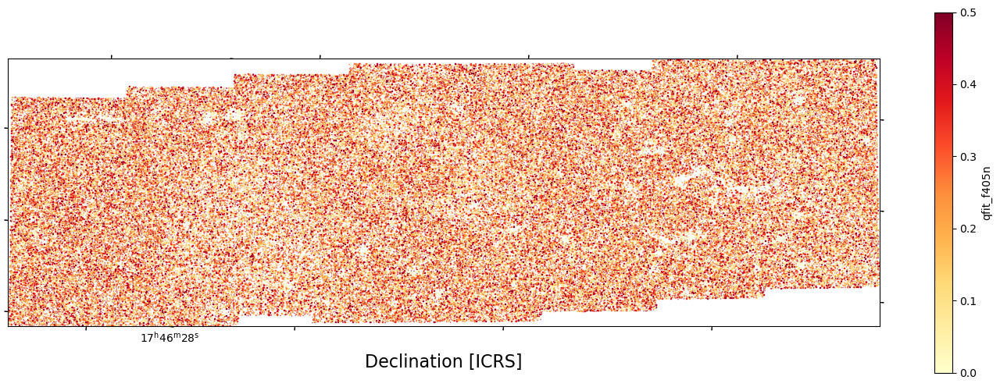

In [143]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use[qf_405_m].ra, crds_use[qf_405_m].dec, c=qf_405[qf_405_m], cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=0.5)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f405n', rotation=90)

Text(0, 0.5, 'qfit_f405n')

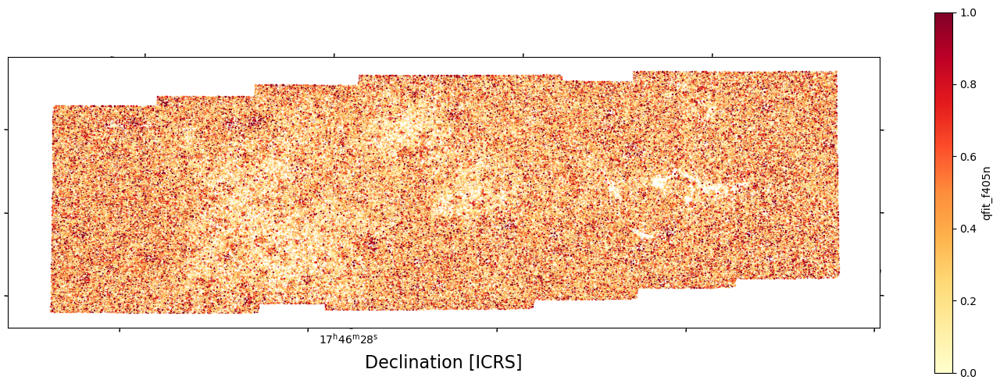

In [127]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use.ra, crds_use.dec, c=qf_405, cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=1)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f405n', rotation=90)

Text(0, 0.5, 'cfit_f405n')

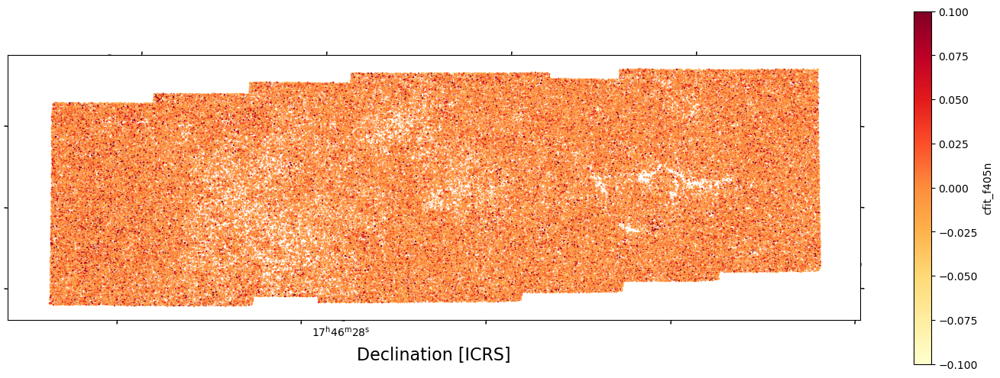

In [163]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use.ra, crds_use.dec, c=cf_405, cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=-0.1, vmax=0.1)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('cfit_f405n', rotation=90)

In [164]:
qf_410 = basetable['qfit_f410m']
cf_410 = basetable['cfit_f410m']
qf_410_m = basetable['qfit_f410m'] < 0.5

In [146]:
len(basetable[qf_410_m])

281334

Text(0, 0.5, 'qfit_f410m')

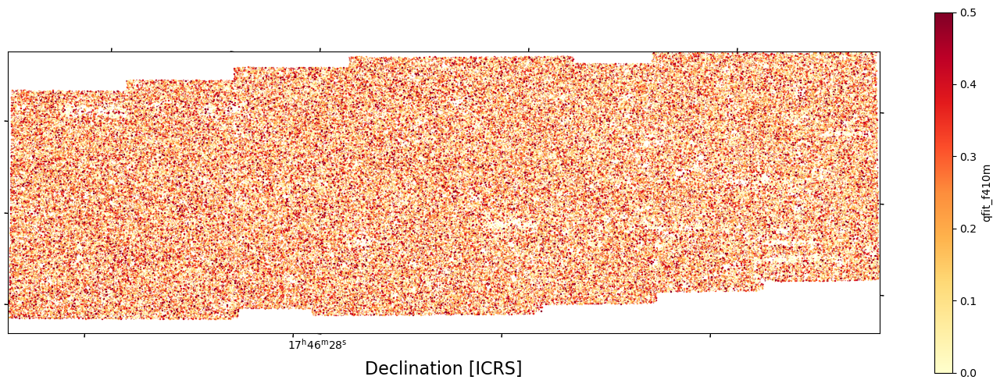

In [147]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use[qf_410_m].ra, crds_use[qf_410_m].dec, c=qf_410[qf_410_m], cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=0.5)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f410m', rotation=90)

Text(0, 0.5, 'qfit_f410m')

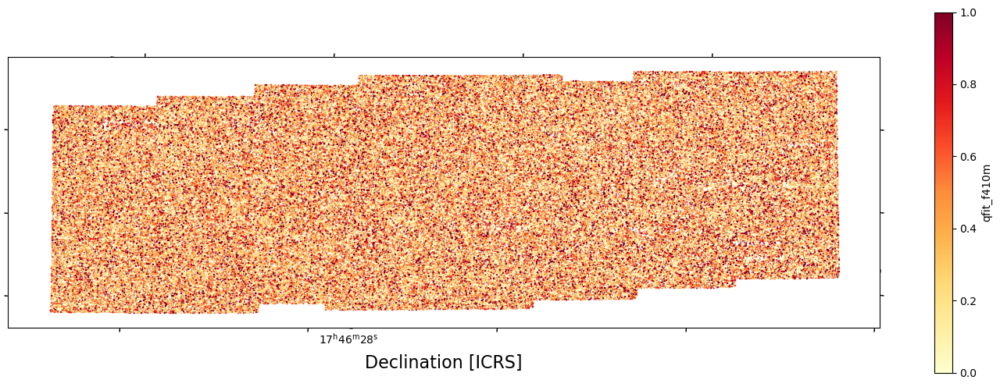

In [102]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use.ra, crds_use.dec, c=qf_410, cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=1)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f410m', rotation=90)

Text(0, 0.5, 'cfit_f410m')

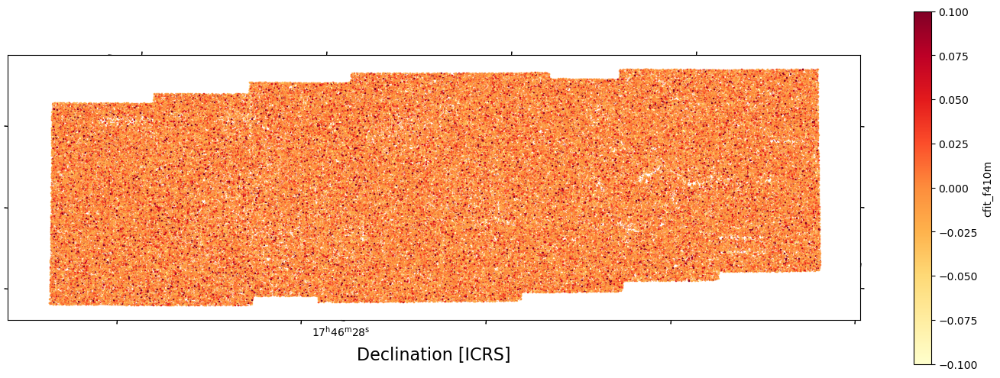

In [165]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use.ra, crds_use.dec, c=cf_410, cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=-0.1, vmax=0.1)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('cfit_f410m', rotation=90)

In [132]:
qf_466 = basetable['qfit_f466n']
qf_466_m = basetable['qfit_f466n'] < 0.5

Text(0, 0.5, 'qfit_f466n')

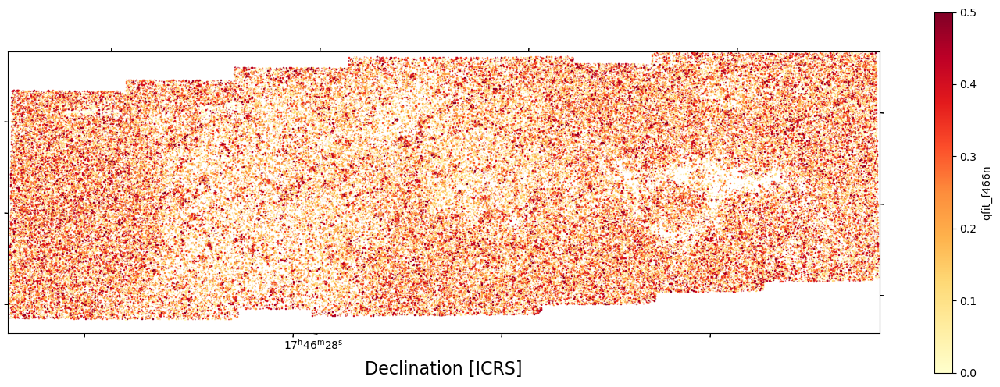

In [133]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use[qf_466_m].ra, crds_use[qf_466_m].dec, c=qf_466[qf_466_m], cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=0.5)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f466n', rotation=90)

Text(0, 0.5, 'qfit_f466n')

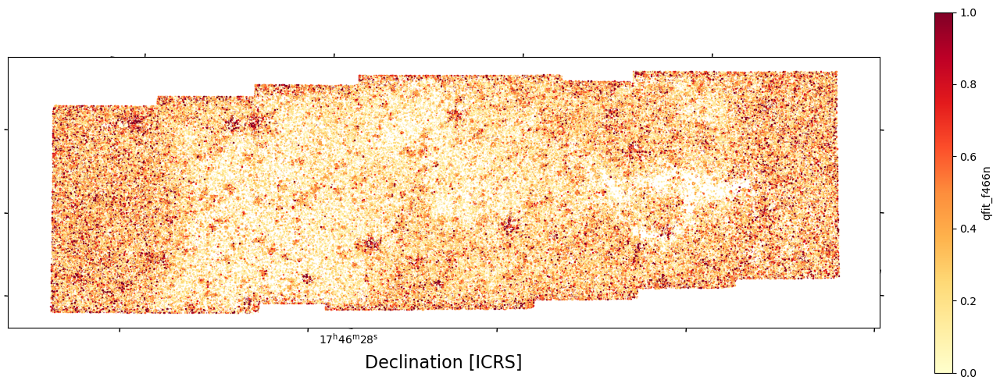

In [104]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use.ra, crds_use.dec, c=qf_466, cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=1)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f466n', rotation=90)

In [150]:
qf_187 = basetable['qfit_f187n']
qf_187_m = basetable['qfit_f187n'] < 0.5

Text(0, 0.5, 'qfit_f187n')

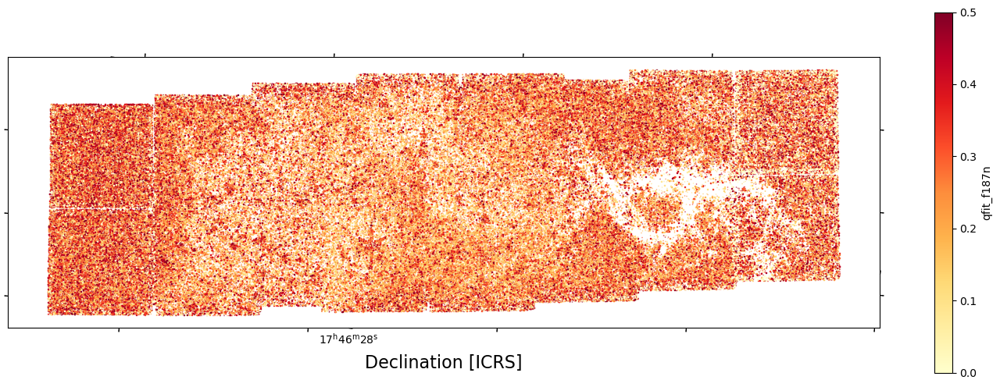

In [151]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use[qf_187_m].ra, crds_use[qf_187_m].dec, c=qf_187[qf_187_m], cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=0.5)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f187n', rotation=90)

Text(0, 0.5, 'qfit_f187n')

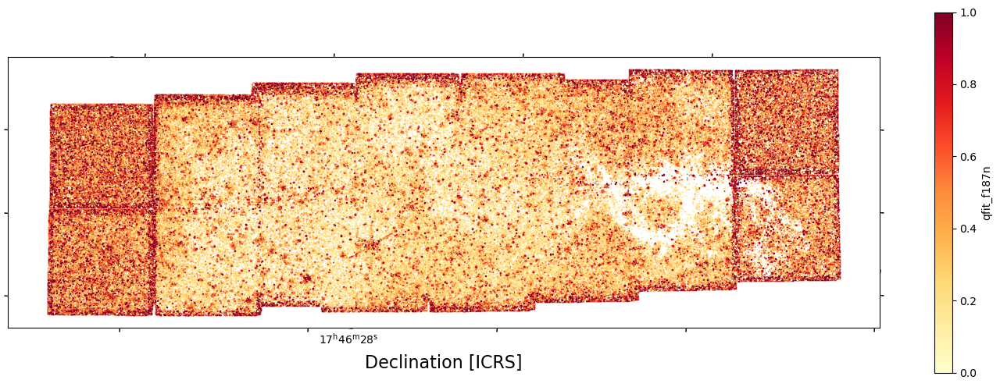

In [106]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use.ra, crds_use.dec, c=qf_187, cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=1)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f187n', rotation=90)

In [152]:
qf_182 = basetable['qfit_f182m']
qf_182_m = basetable['qfit_f182m'] < 0.5


Text(0, 0.5, 'qfit_f182m')

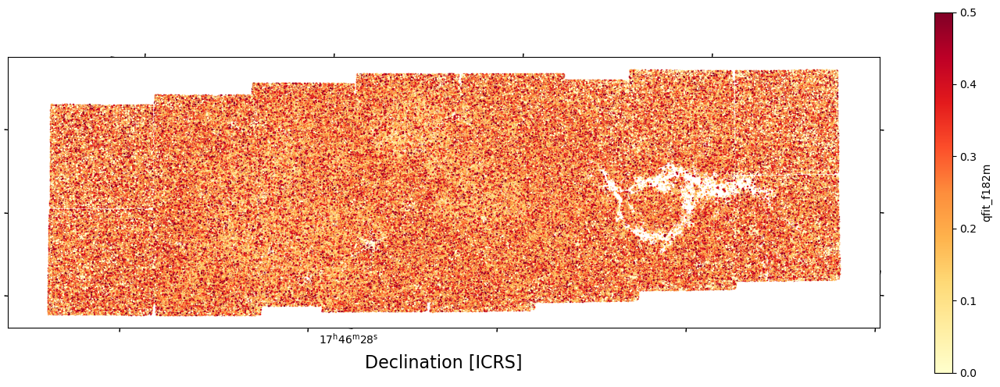

In [154]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use[qf_182_m].ra, crds_use[qf_182_m].dec, c=qf_182[qf_182_m], cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=0.5)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f182m', rotation=90)

Text(0, 0.5, 'qfit_f182m')

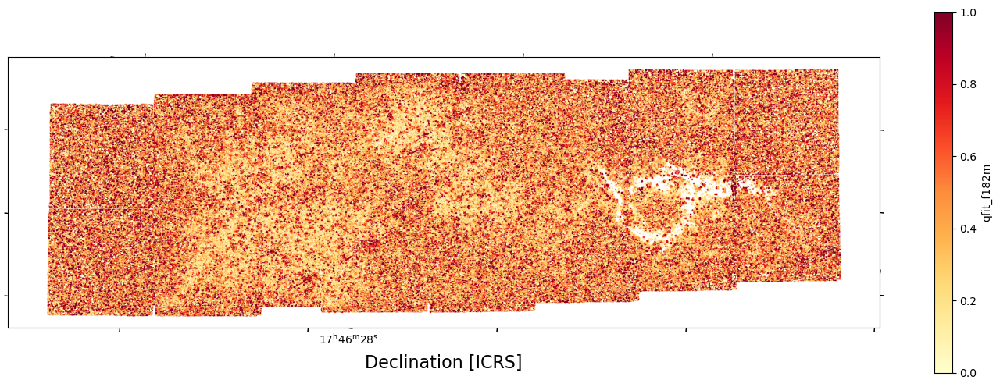

In [153]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use.ra, crds_use.dec, c=qf_182, cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=1)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f182m', rotation=90)

In [155]:
qf_212 = basetable['qfit_f212n']
qf_212_m = basetable['qfit_f212n'] < 0.5

Text(0, 0.5, 'qfit_f212n')

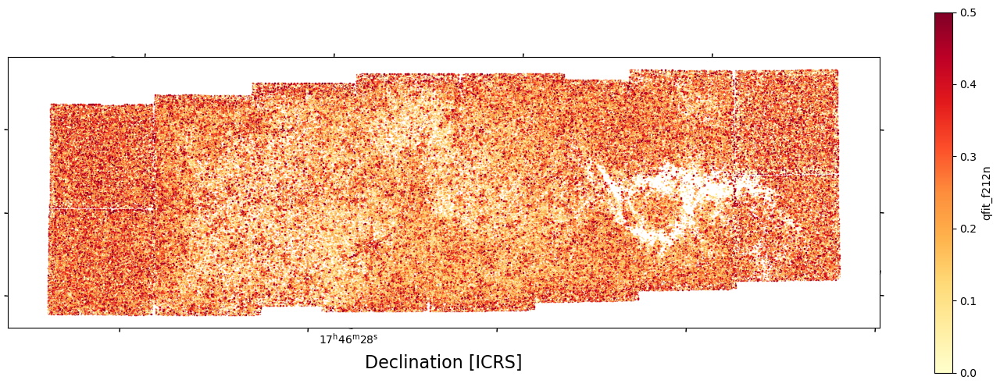

In [156]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use[qf_212_m].ra, crds_use[qf_212_m].dec, c=qf_212[qf_212_m], cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=0.5)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f212n', rotation=90)

Text(0, 0.5, 'qfit_f212n')

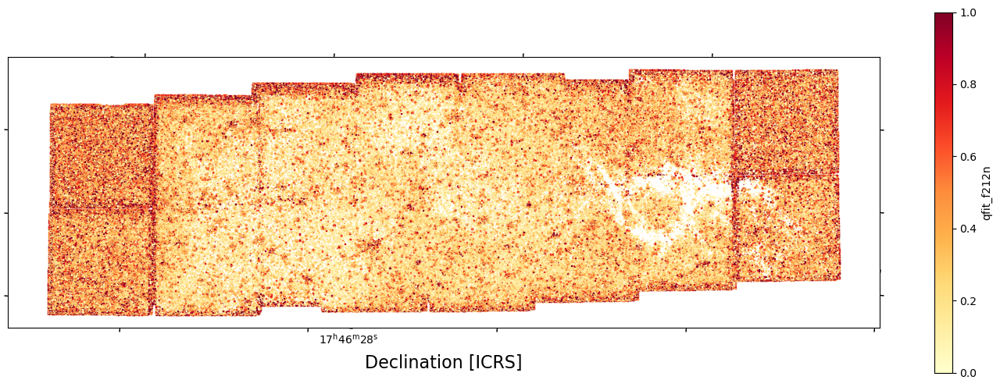

In [157]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use.ra, crds_use.dec, c=qf_212, cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=0.1, vmin=0, vmax=1)
#ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f212n', rotation=90)

Text(0, 0.5, 'qfit_466')

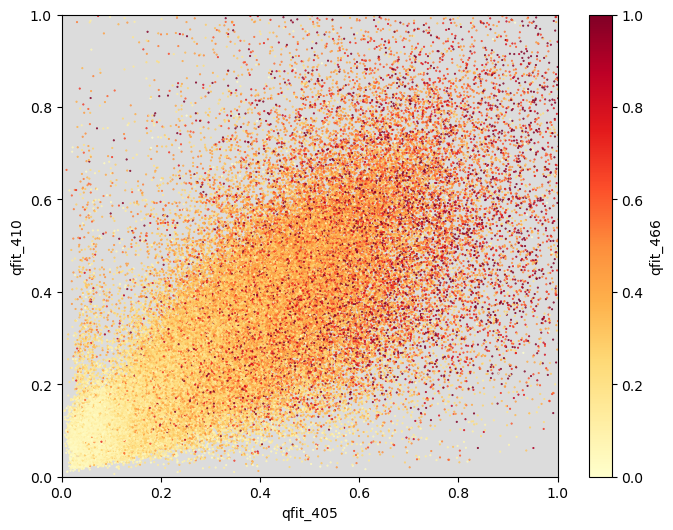

In [118]:
fig = plt.figure(figsize=(8, 6))

ax2 = plt.subplot(111)
im = ax2.scatter(qf_405, qf_410, c=qf_466, marker='.', cmap='YlOrRd', s=1, vmin=0, vmax=1)
ax2.set_xlabel('qfit_405')
ax2.set_ylabel('qfit_410')
ax2.set_xlim(left=0, right=1)
ax2.set_ylim(bottom=0, top=1)
ax2.set_facecolor('gainsboro')

cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_466', rotation=90)

Text(0, 0.5, 'qfit_212')

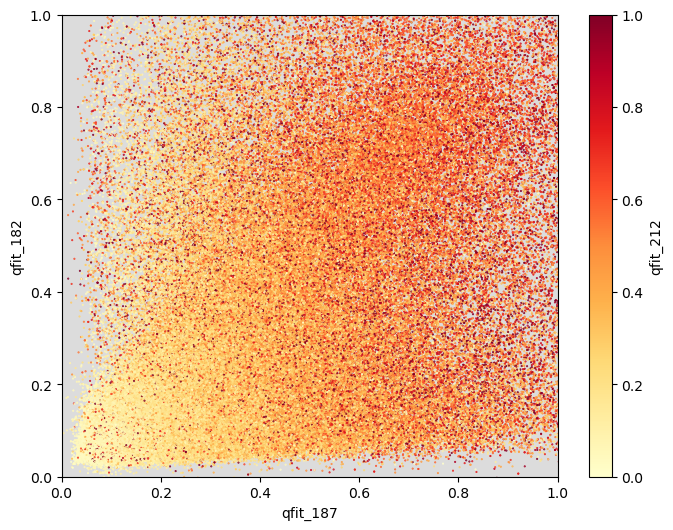

In [119]:
fig = plt.figure(figsize=(8, 6))

ax2 = plt.subplot(111)
im = ax2.scatter(qf_187, qf_182, c=qf_212, marker='.', cmap='YlOrRd', s=1, vmin=0, vmax=1)
ax2.set_xlabel('qfit_187')
ax2.set_ylabel('qfit_182')
ax2.set_xlim(left=0, right=1)
ax2.set_ylim(bottom=0, top=1)
ax2.set_facecolor('gainsboro')

cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_212', rotation=90)

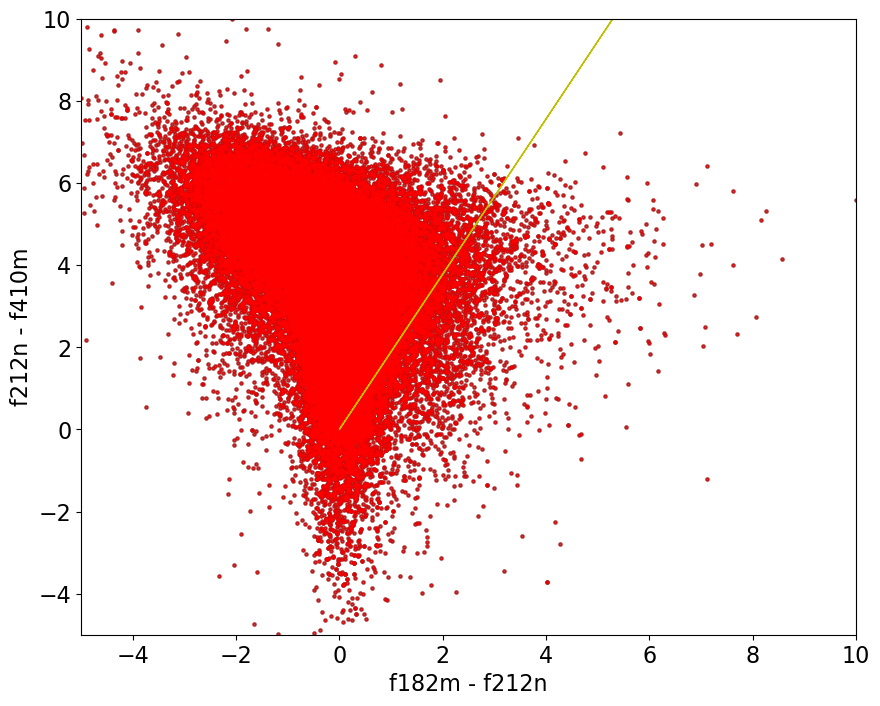

In [25]:
ax = plt.subplot(111)
plot_tools.ccd(basetable, ax, ('f182m', 'f212n'), ('f212n', 'f410m'))

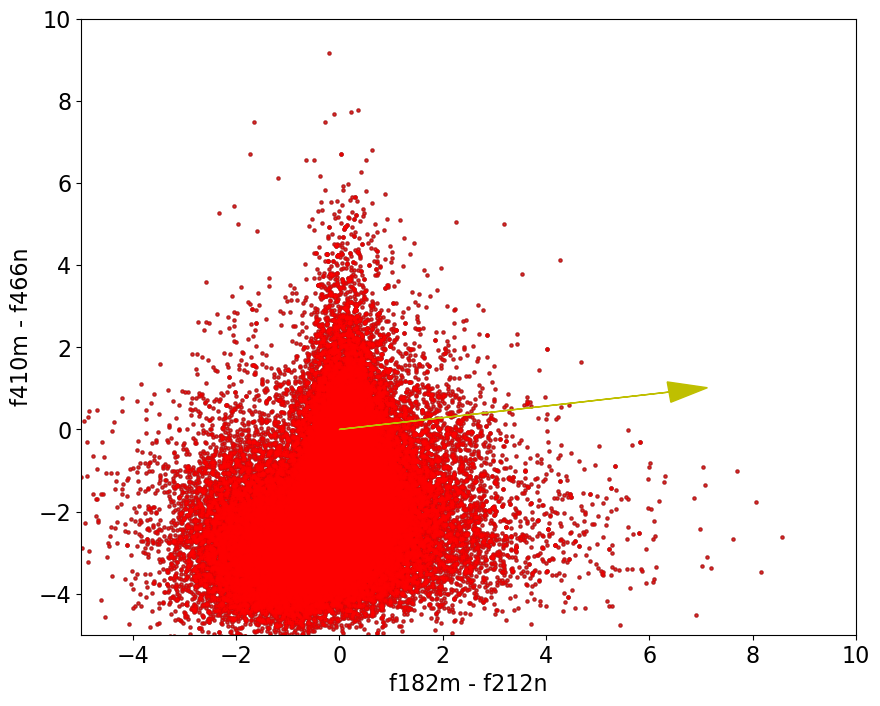

In [26]:
ax = plt.subplot(111)
plot_tools.ccd(basetable, ax, ('f182m', 'f212n'), ('f410m', 'f466n'))

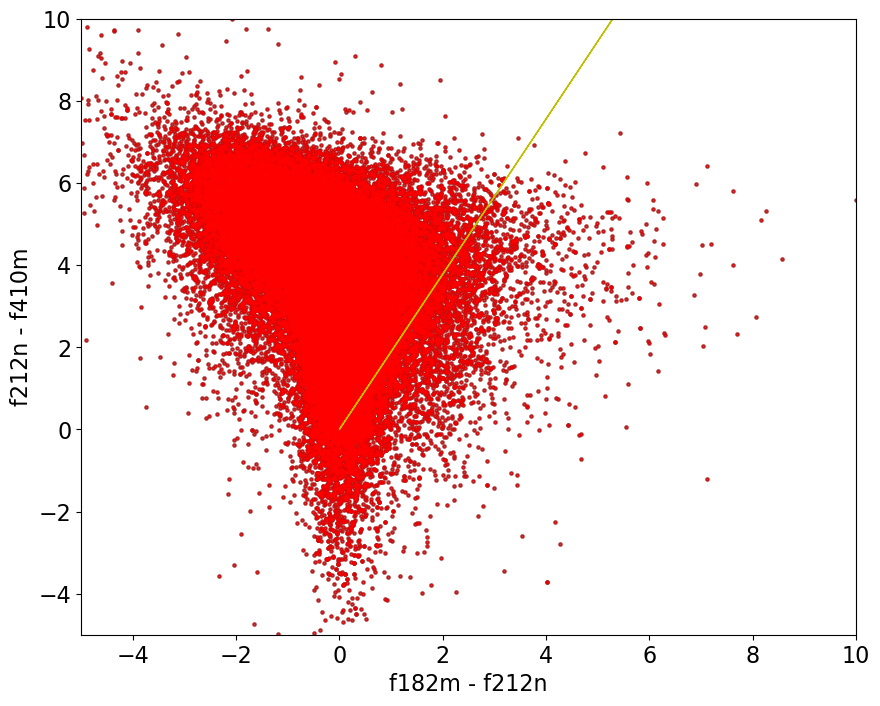

In [27]:
ax = plt.subplot(111)
plot_tools.ccd(basetable, ax, ('f182m', 'f212n'), ('f212n', 'f410m'))

In [49]:
mir_cat = Table.read('/orange/adamginsburg/jwst/cloudc/catalogs/miri_good_matches_crowdsource_nsky1_photometry_tables_merged.fits')

In [50]:
mir_use = mir_cat[mir_cat['good_match']]
mir_use_crds = mir_use['skycoord_f2550w']

In [51]:
color_mir = mir_use['mag_ab_f187n'] - mir_use['mag_ab_f405n']

Text(0, 0.5, '[F187N] - [F405N]')

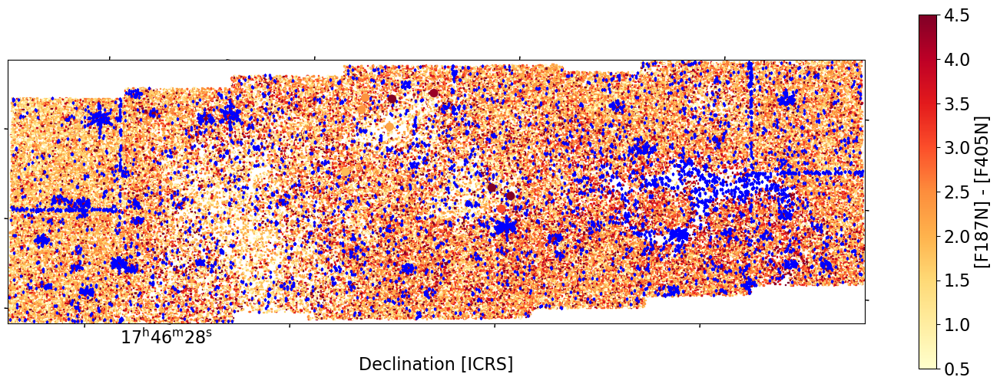

In [52]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(nandata, vmin=0, vmax=50)
im = ax.scatter(crds_use.ra, crds_use.dec, c=color, cmap='YlOrRd', transform=ax.get_transform('world'), marker=',', s=1, vmin=0.5, vmax=4.5)
ax.scatter(crds_other.ra, crds_other.dec, color='blue', marker=',', s=1, transform=ax.get_transform('world'))
ax.scatter(mir_use['skycoord_f2550w'].ra, mir_use['skycoord_f2550w'].dec, c=color_mir, cmap='YlOrRd', transform=ax.get_transform('world'), s=50, vmin=0.5, vmax=4.5)
plt.xticks([]);
plt.yticks([]);
ax.set_xlabel('Declination [ICRS]', fontsize=16)
ax.set_ylabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('[F187N] - [F405N]', rotation=90)

In [53]:
color_x_mir =  mir_use['mag_ab_f182m'] - mir_use['mag_ab_f212n']
color_y1_mir = mir_use['mag_ab_f212n'] - mir_use['mag_ab_f410m']
color_y2_mir = mir_use['mag_ab_f410m'] - mir_use['mag_ab_f466n']

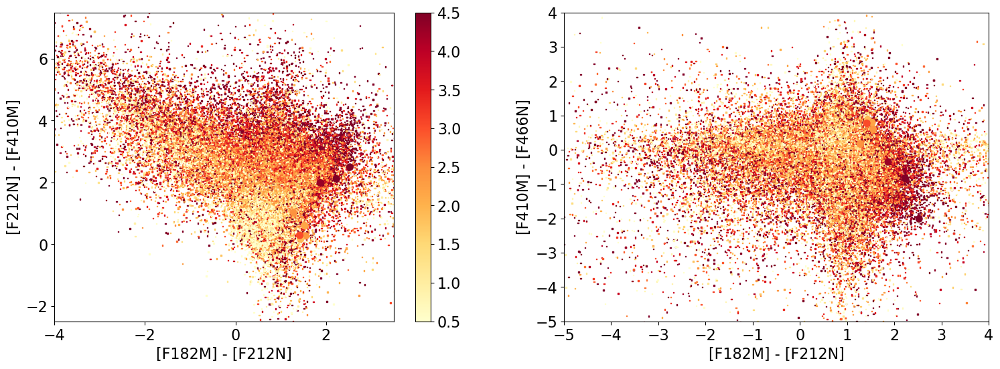

In [54]:
fig = plt.figure(figsize=(18, 6))

ax1 = plt.subplot(121)
im = ax1.scatter(color_x, color_y1, c=color, marker=',', s=1, vmin=0.5, vmax=4.5, cmap='YlOrRd')
ax1.scatter(color_x_mir, color_y1_mir, c=color_mir, vmin=0.5, vmax=4.5, cmap='YlOrRd', s=50)
ax1.set_xlabel('[F182M] - [F212N]')
ax1.set_ylabel('[F212N] - [F410M]')
ax1.set_xlim(left=-4, right=3.5)
ax1.set_ylim(bottom=-2.5, top=7.5)

ax2 = plt.subplot(122)
ax2.scatter(color_x, color_y2, c=color, marker=',', s=1, vmin=0.5, vmax=4.5, cmap='YlOrRd')
ax2.scatter(color_x_mir, color_y2_mir, c=color_mir, vmin=0.5, vmax=4.5, cmap='YlOrRd', s=50)
ax2.set_xlabel('[F182M] - [F212N]')
ax2.set_ylabel('[F410M] - [F466N]')
ax2.set_xlim(left=-5, right=4)
ax2.set_ylim(bottom=-5, top=4)

cbar = fig.colorbar(im)

In [55]:
color_y3_mir = mir_use['mag_ab_f405n'] - mir_use['mag_ab_f410m']
color_y4_mir = mir_use['mag_ab_f187n'] - mir_use['mag_ab_f182m']
color_y5_mir = mir_use['mag_ab_f212n'] - mir_use['mag_ab_f182m']

Text(0, 0.5, '[F212N] - [F182M]')

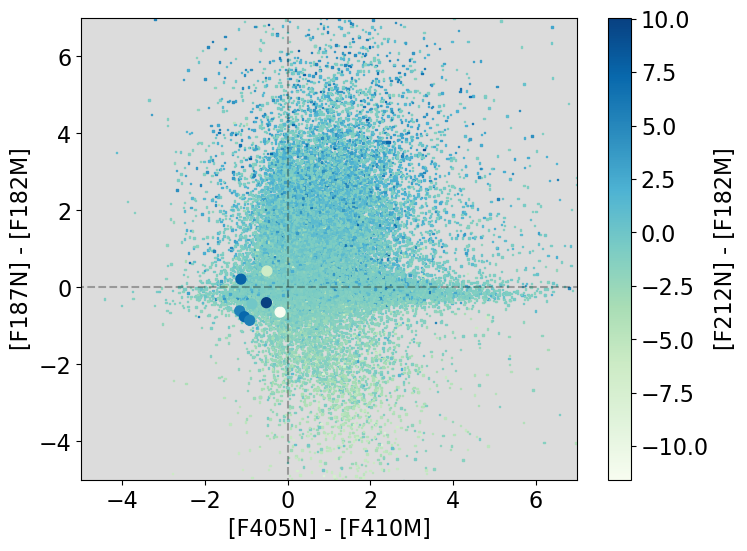

In [56]:
fig = plt.figure(figsize=(8, 6))

ax2 = plt.subplot(111)
im = ax2.scatter(color_y3, color_y4, c=color_y5, marker=',', s=1, cmap='GnBu')#, vmin=-5, vmax=4)
ax2.scatter(color_y3_mir, color_y4_mir, c=color_y5_mir,cmap='GnBu', s=50)#, vmin=0.5, vmax=4.5, )
ax2.set_xlabel('[F405N] - [F410M]')
ax2.set_ylabel('[F187N] - [F182M]')
ax2.set_xlim(left=-5, right=7)
ax2.set_ylim(bottom=-5, top=7)
ax2.set_facecolor('gainsboro')
plt.hlines(0, xmin=-10, xmax=10, color='k', linestyle='--', alpha=0.3)
plt.vlines(0, ymin=-10, ymax=10, color='k', linestyle='--', alpha=0.3)

cbar = fig.colorbar(im)
cbar.ax.set_ylabel('[F212N] - [F182M]', rotation=90)

# Cutout

In [52]:
position_hmsfr = SkyCoord('17:46:21.4695266413', '-28:35:38.2082071644', unit=(u.hourangle, u.deg))
l = 1*u.arcmin
w = 1*u.arcmin

In [55]:
rgb, ww = get_cutout_rgb_alt(position_hmsfr, l, w)
reg_cloudc = regions.RectangleSkyRegion(center=position_hmsfr, width=w, height=l)
tbl_in = tbl_use[reg_cloudc.contains(crds_use, wcs=ww)]
crds_in = crds_use[reg_cloudc.contains(crds_use, wcs=ww)]
#crds_other_in = crds_other[reg_cloudc.contains(crds_other, wcs=ww)]

## QF Investigation

In [185]:
position_hmsfr = SkyCoord('17:46:21.4695266413', '-28:35:38.2082071644', unit=(u.hourangle, u.deg))
l_ = 20*u.arcsec
w_ = 20*u.arcsec

cutout_405 = get_cutout_405(position_hmsfr, l_, w_)
cutout_212 = get_cutout_212(position_hmsfr, l_, w_)

reg_cloudc_ = regions.RectangleSkyRegion(center=position_hmsfr, width=w_, height=l_)

tbl_in_ = basetable[reg_cloudc_.contains(basetable['skycoord_ref'], wcs=ww)]
#tbl_use[reg_cloudc_.contains(crds_use, wcs=ww)]
crds_in_ = tbl_in_['skycoord_ref']
#crds_use[reg_cloudc_.contains(crds_use, wcs=ww)]

In [170]:
qf_405 = tbl_in_['qfit_f405n']
cf_405 = tbl_in_['cfit_f405n']
qf_405_m = tbl_in_['qfit_f405n'] < 0.4
cf_405_m = tbl_in_['cfit_f405n'] < 0.01
mask_405 = ~np.isnan(tbl_in_['mag_ab_f405n'])

In [171]:
print(len(tbl_in_[mask_405]))
print(len(tbl_in_[qf_405_m]))

1260
782


Text(0, 0.5, 'qfit_f405n')

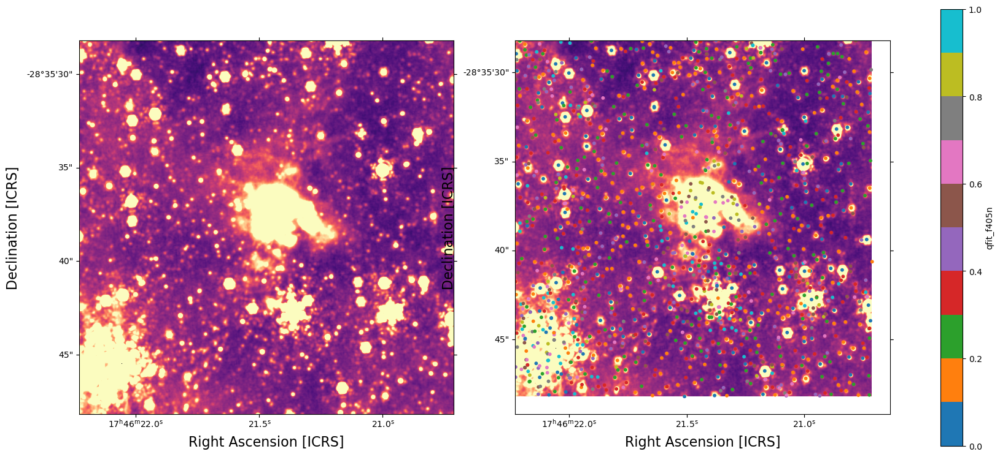

In [183]:
fig = plt.figure(figsize=(18, 8))
#ax = plt.subplot(111, projection=ww)

ax2 = plt.subplot(121, projection=cutout_405.wcs)
ax2.imshow(cutout_405.data, vmin=0, vmax=25, cmap='magma')
ax2.set_ylabel('Declination [ICRS]', fontsize=16)
ax2.set_xlabel('Right Ascension [ICRS]', fontsize=16)

ax = plt.subplot(122, projection=cutout_405.wcs)
#ax.imshow(rgb, vmin=0, vmax=50)
ax.imshow(cutout_405.data, vmin=0, vmax=25, cmap='magma')
#ax.scatter(crds_in_.ra, crds_in_.dec, edgecolor='magenta', facecolor='none', transform=ax.get_transform('world'), s=1)
im = ax.scatter(crds_in_.ra, crds_in_.dec, c=qf_405, cmap='tab10', transform=ax.get_transform('world'), s=10, vmin=0, vmax=1)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=1)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
fig.tight_layout()


cbar = fig.colorbar(im, ax=[ax, ax2])
cbar.ax.set_ylabel('qfit_f405n', rotation=90)



In [195]:
qf_212 = tbl_in_['qfit_f212n']
qf_212_m = tbl_in_['qfit_f212n'] < 0.4

Text(0, 0.5, 'qfit_f212n')

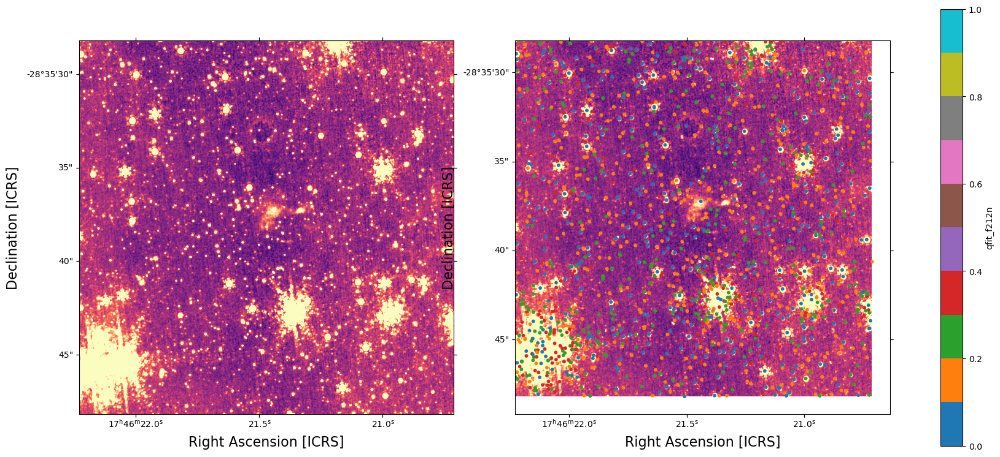

In [196]:
fig = plt.figure(figsize=(18, 8))

ax2 = plt.subplot(121, projection=cutout_212.wcs)
ax2.imshow(cutout_212.data, vmin=0, vmax=25, cmap='magma')
ax2.set_ylabel('Declination [ICRS]', fontsize=16)
ax2.set_xlabel('Right Ascension [ICRS]', fontsize=16)

ax = plt.subplot(122, projection=cutout_212.wcs)
ax.imshow(cutout_212.data, vmin=0, vmax=25, cmap='magma')
#im = ax.scatter(crds_in_.ra, crds_in_.dec, c=qf_212, cmap='tab10', transform=ax.get_transform('world'), s=10, vmin=0, vmax=1)
im = ax.scatter(crds_in_[qf_212_m].ra, crds_in_[qf_212_m].dec, c=qf_212[qf_212_m], cmap='tab10', transform=ax.get_transform('world'), s=10, vmin=0, vmax=1)

ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
fig.tight_layout()


cbar = fig.colorbar(im, ax=[ax, ax2])
cbar.ax.set_ylabel('qfit_f212n', rotation=90)



In [207]:
combined_qf = np.nansum(np.array([tbl_in_['qfit_f187n'], tbl_in_['qfit_f182m'], tbl_in_['qfit_f212n'],
                             tbl_in_['qfit_f405n'], tbl_in_['qfit_f410m'], tbl_in_['qfit_f466n']]), axis=0)

In [208]:
combined_qf.shape

(4036,)

Text(0, 0.5, 'qfit_combined')

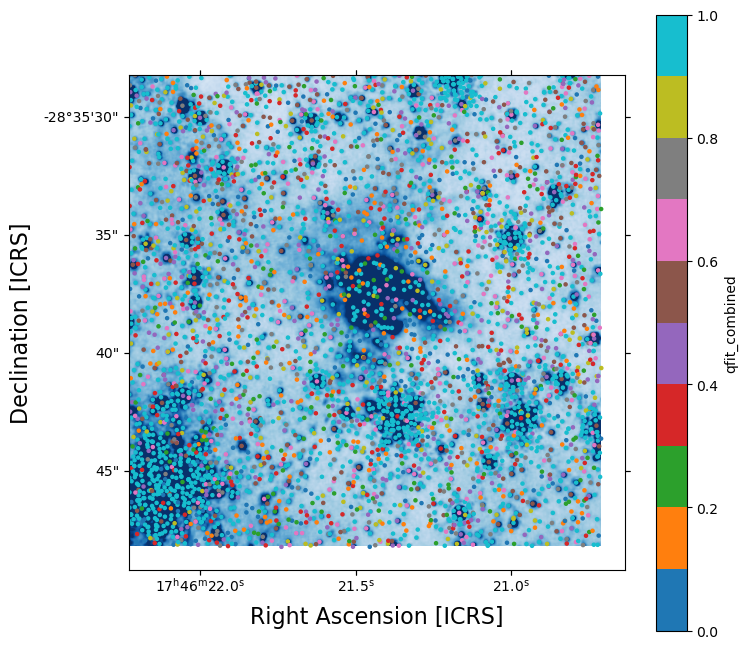

In [211]:
fig = plt.figure(figsize=(8, 8))
#ax = plt.subplot(111, projection=ww)
ax = plt.subplot(111, projection=cutout_405.wcs)
#ax.imshow(rgb, vmin=0, vmax=50)
ax.imshow(cutout_405.data, vmin=0, vmax=25, cmap='Blues')
#ax.scatter(crds_in_[mask_405].ra, crds_in_[mask_405].dec, edgecolor='magenta', facecolor='none', transform=ax.get_transform('world'), s=1)
im = ax.scatter(crds_in_.ra, crds_in_.dec, c=combined_qf, cmap='tab10', transform=ax.get_transform('world'), s=5, vmin=0, vmax=1)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=1)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_combined', rotation=90)

Text(0, 0.5, 'qfit_f405n')

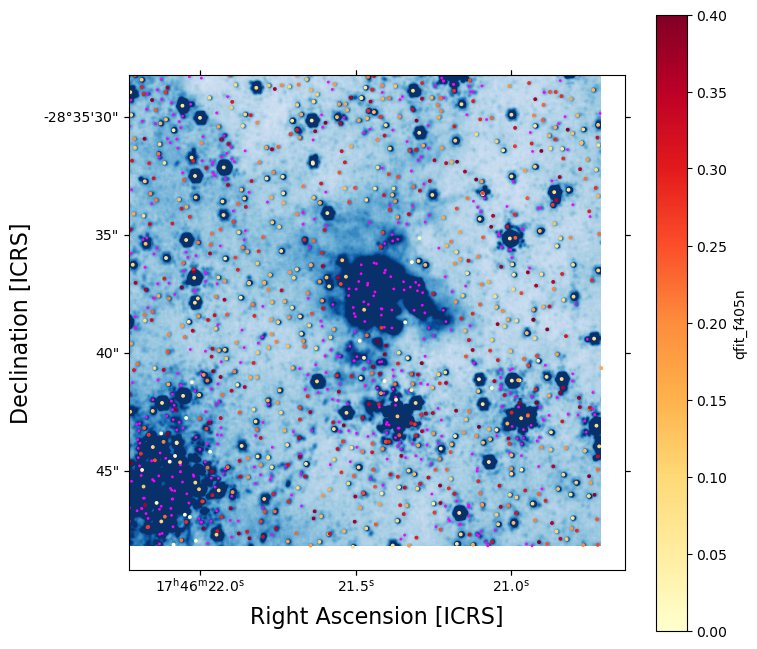

In [173]:
fig = plt.figure(figsize=(8, 8))
#ax = plt.subplot(111, projection=ww)
ax = plt.subplot(111, projection=cutout_405.wcs)
#ax.imshow(rgb, vmin=0, vmax=50)
ax.imshow(cutout_405.data, vmin=0, vmax=25, cmap='Blues')
ax.scatter(crds_in_[mask_405].ra, crds_in_[mask_405].dec, edgecolor='magenta', facecolor='none', transform=ax.get_transform('world'), s=1)
im = ax.scatter(crds_in_[qf_405_m].ra, crds_in_[qf_405_m].dec, c=qf_405[qf_405_m], cmap='YlOrRd', transform=ax.get_transform('world'), s=3, vmin=0, vmax=0.4)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=1)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f405n', rotation=90)

(array([148., 220., 212., 185., 133.,  99.,  91.,  53.,  43.,  22.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

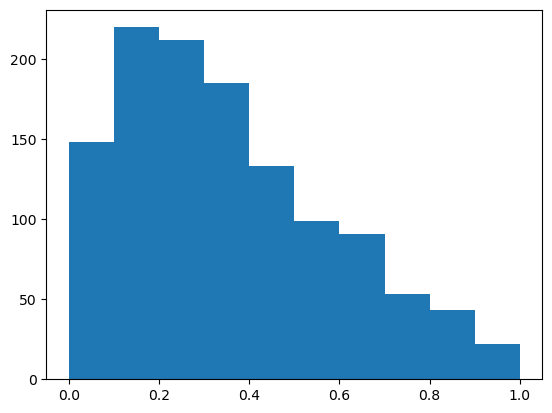

In [288]:
plt.hist(qf_405, bins=np.linspace(0, 1, num=11))

In [264]:
qf_410 = tbl_in_['qfit_f410m']
cf_410 = tbl_in_['cfit_f410m']
qf_410_m = tbl_in_['qfit_f410m'] < 0.4
cf_410_m = tbl_in_['cfit_f410m'] < 0.01
mask_410 = ~np.isnan(tbl_in_['mag_ab_f410m'])
cutout_410 = get_cutout_410(position_hmsfr, l_, w_)

In [295]:
print(len(tbl_in_[mask_410]))
print(len(tbl_in_[qf_410_m]))

1835
1174


Text(0, 0.5, 'qfit_f410m')

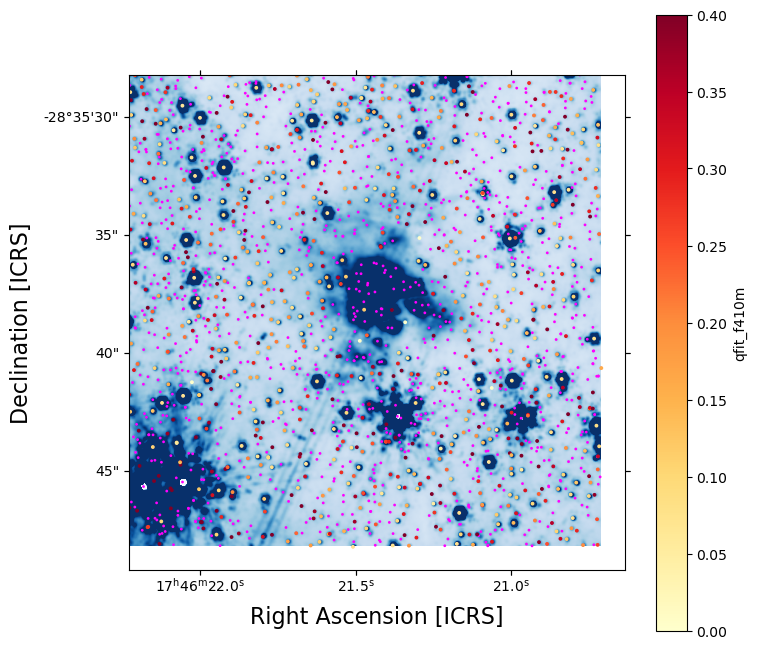

In [265]:
fig = plt.figure(figsize=(8, 8))
#ax = plt.subplot(111, projection=ww)
ax = plt.subplot(111, projection=cutout_410.wcs)
#ax.imshow(rgb, vmin=0, vmax=50)
ax.imshow(cutout_410.data, vmin=0, vmax=25, cmap='Blues')
ax.scatter(crds_in_[mask_410].ra, crds_in_[mask_410].dec, edgecolor='magenta', facecolor='none', transform=ax.get_transform('world'), s=1)
im = ax.scatter(crds_in_[qf_410_m].ra, crds_in_[qf_410_m].dec, c=qf_405[qf_410_m], cmap='YlOrRd', transform=ax.get_transform('world'), s=3, vmin=0, vmax=0.4)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=1)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f410m', rotation=90)

(array([183., 339., 231., 223., 161., 173., 163.,  91.,  63.,  24.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

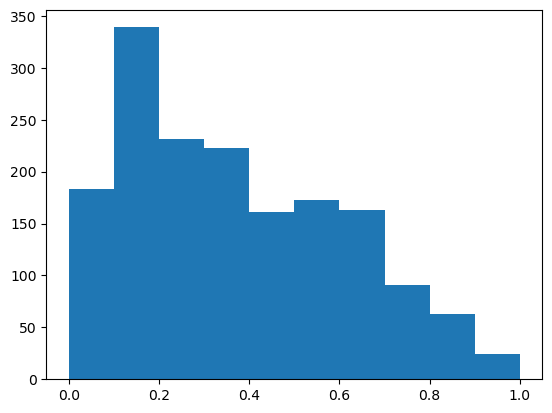

In [289]:
plt.hist(qf_410, bins=np.linspace(0, 1, num=11))

In [266]:
qf_466 = tbl_in_['qfit_f466n']
cf_466 = tbl_in_['cfit_f466n']
qf_466_m = tbl_in_['qfit_f466n'] < 0.4
cf_466_m = tbl_in_['cfit_f466n'] < 0.01
mask_466 = ~np.isnan(tbl_in_['mag_ab_f466n'])
cutout_466 = get_cutout_466(position_hmsfr, l_, w_)

In [296]:
print(len(tbl_in_[mask_466]))
print(len(tbl_in_[qf_466_m]))

924
711


Text(0, 0.5, 'qfit_f466n')

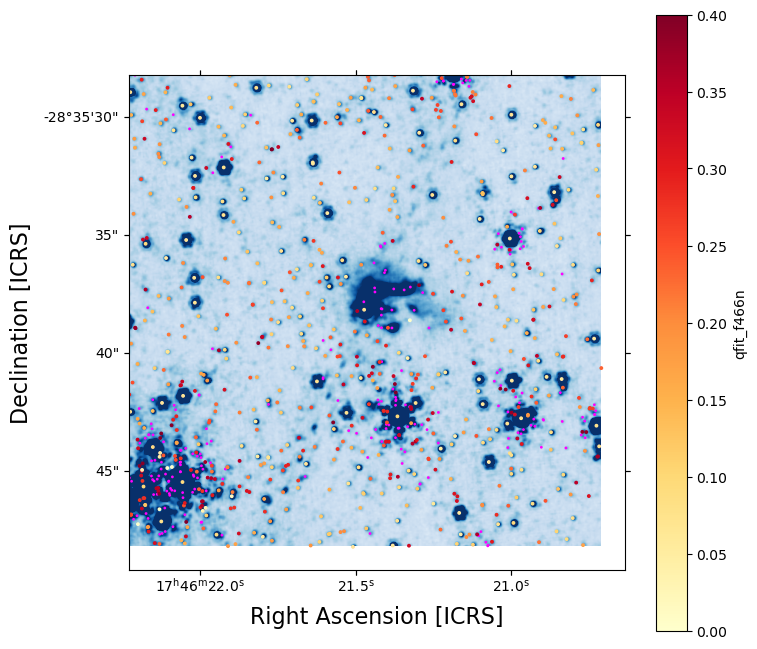

In [267]:
fig = plt.figure(figsize=(8, 8))
#ax = plt.subplot(111, projection=ww)
ax = plt.subplot(111, projection=cutout_466.wcs)
#ax.imshow(rgb, vmin=0, vmax=50)
ax.imshow(cutout_466.data, vmin=0, vmax=25, cmap='Blues')
ax.scatter(crds_in_[mask_466].ra, crds_in_[mask_466].dec, edgecolor='magenta', facecolor='none', transform=ax.get_transform('world'), s=1)
im = ax.scatter(crds_in_[qf_466_m].ra, crds_in_[qf_466_m].dec, c=qf_466[qf_466_m], cmap='YlOrRd', transform=ax.get_transform('world'), s=3, vmin=0, vmax=0.4)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=1)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f466n', rotation=90)

(array([143., 235., 199., 129., 114.,  46.,  33.,   8.,   7.,   6.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

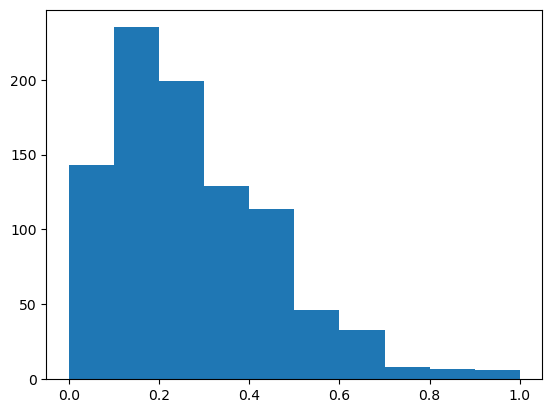

In [290]:
plt.hist(qf_466, bins=np.linspace(0, 1, num=11))

In [268]:
qf_187 = tbl_in_['qfit_f187n']
cf_187 = tbl_in_['cfit_f187n']
qf_187_m = tbl_in_['qfit_f187n'] < 0.4
cf_187_m = tbl_in_['cfit_f187n'] < 0.01
mask_187 = ~np.isnan(tbl_in_['mag_ab_f187n'])
cutout_187 = get_cutout_187(position_hmsfr, l_, w_)

In [297]:
print(len(tbl_in_[mask_187]))
print(len(tbl_in_[qf_187_m]))

1612
1129


Text(0, 0.5, 'qfit_f187n')

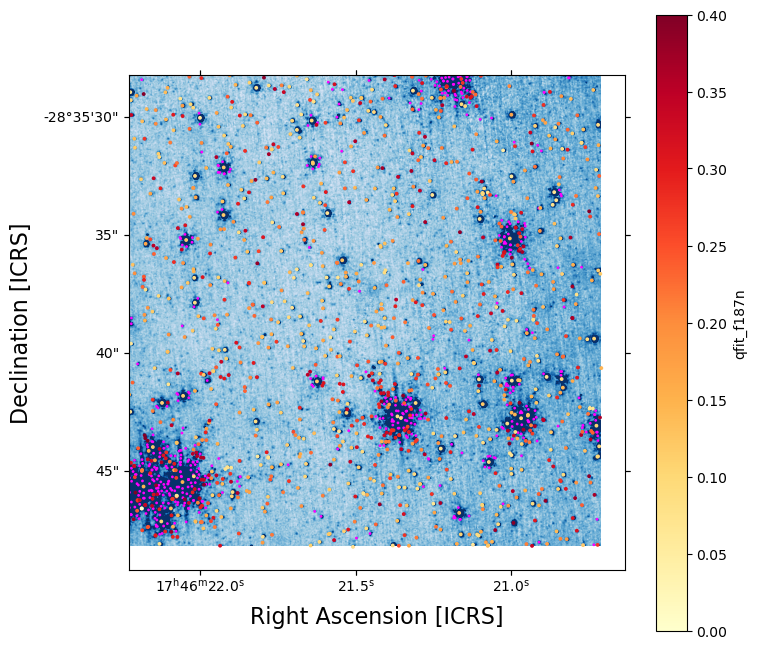

In [269]:
fig = plt.figure(figsize=(8, 8))
#ax = plt.subplot(111, projection=ww)
ax = plt.subplot(111, projection=cutout_187.wcs)
#ax.imshow(rgb, vmin=0, vmax=50)
ax.imshow(cutout_187.data, vmin=0, vmax=25, cmap='Blues')
ax.scatter(crds_in_[mask_187].ra, crds_in_[mask_187].dec, edgecolor='magenta', facecolor='none', transform=ax.get_transform('world'), s=1)
im = ax.scatter(crds_in_[qf_187_m].ra, crds_in_[qf_187_m].dec, c=qf_187[qf_187_m], cmap='YlOrRd', transform=ax.get_transform('world'), s=3, vmin=0, vmax=0.4)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=1)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f187n', rotation=90)

(array([159., 430., 331., 207., 121.,  78.,  91.,  73.,  47.,  32.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

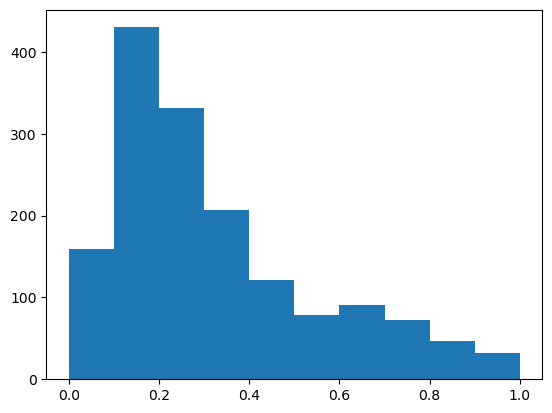

In [291]:
plt.hist(qf_187, bins=np.linspace(0, 1, num=11))

In [270]:
qf_182 = tbl_in_['qfit_f182m']
cf_182 = tbl_in_['cfit_f182m']
qf_182_m = tbl_in_['qfit_f182m'] < 0.4
cf_182_m = tbl_in_['cfit_f182m'] < 0.01
mask_182 = ~np.isnan(tbl_in_['mag_ab_f182m'])
cutout_182 = get_cutout_182(position_hmsfr, l_, w_)

In [298]:
print(len(tbl_in_[mask_182]))
print(len(tbl_in_[qf_182_m]))

3537
2325


Text(0, 0.5, 'qfit_f182m')

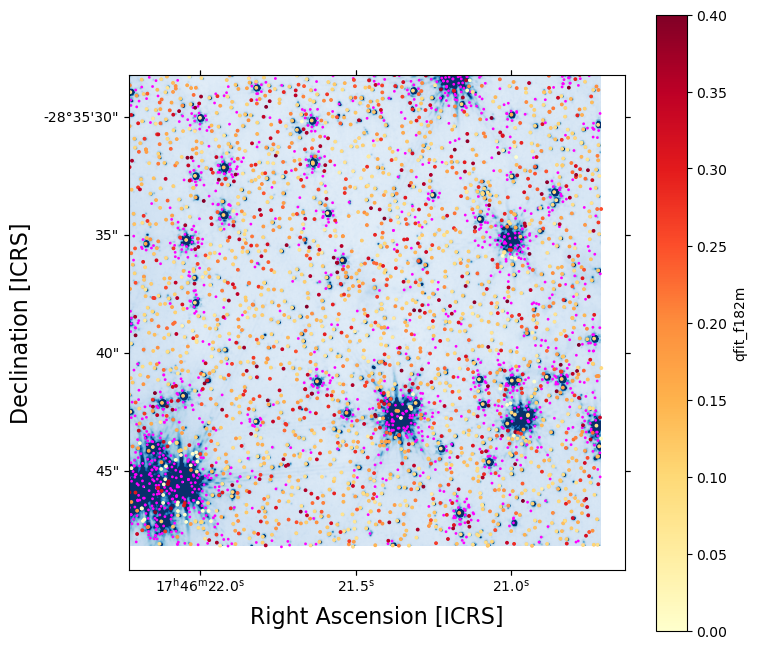

In [273]:
fig = plt.figure(figsize=(8, 8))
#ax = plt.subplot(111, projection=ww)
ax = plt.subplot(111, projection=cutout_182.wcs)
#ax.imshow(rgb, vmin=0, vmax=50)
ax.imshow(cutout_182.data, vmin=0, vmax=25, cmap='Blues')
ax.scatter(crds_in_[mask_182].ra, crds_in_[mask_182].dec, edgecolor='magenta', facecolor='none', transform=ax.get_transform('world'), s=1)
im = ax.scatter(crds_in_[qf_182_m].ra, crds_in_[qf_182_m].dec, c=qf_182[qf_182_m], cmap='YlOrRd', transform=ax.get_transform('world'), s=3, vmin=0, vmax=0.4)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=1)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f182m', rotation=90)

(array([571., 987., 412., 310., 284., 202., 180., 160., 127.,  85.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

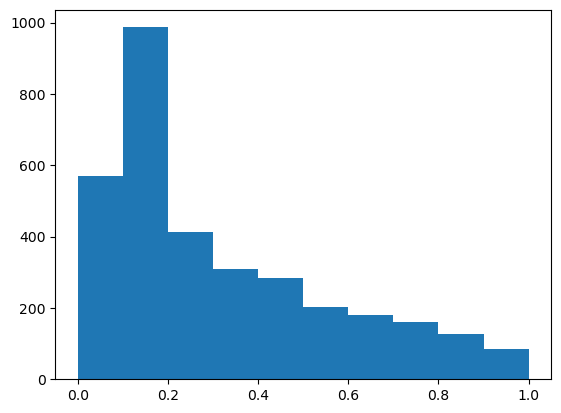

In [292]:
plt.hist(qf_182, bins=np.linspace(0, 1, num=11))

In [274]:
qf_212 = tbl_in_['qfit_f212n']
cf_212 = tbl_in_['cfit_f212n']
qf_212_m = tbl_in_['qfit_f212n'] < 0.4
cf_212_m = tbl_in_['cfit_f212n'] < 0.01
mask_212 = ~np.isnan(tbl_in_['mag_ab_f212n'])
cutout_212 = get_cutout_212(position_hmsfr, l_, w_)

In [299]:
print(len(tbl_in_[mask_212]))
print(len(tbl_in_[qf_212_m]))

1803
1416


Text(0, 0.5, 'qfit_f212n')

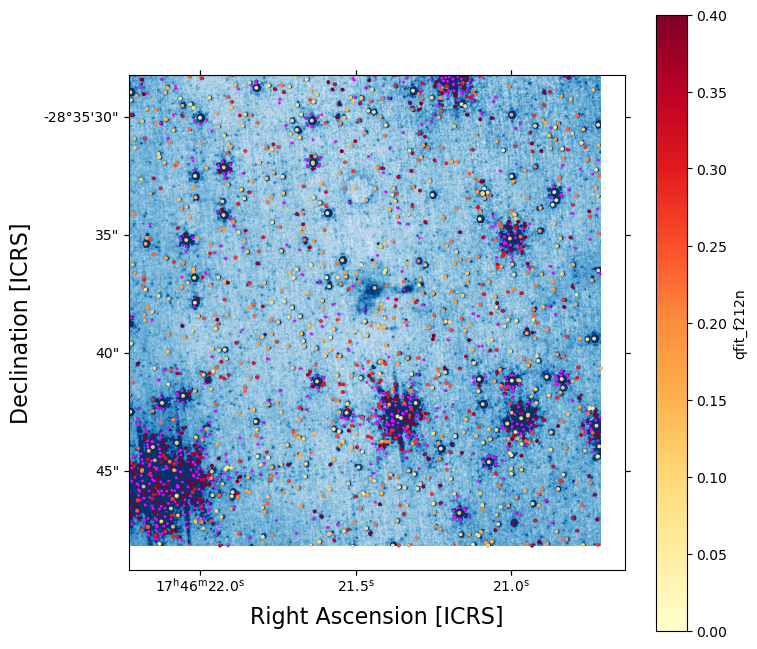

In [275]:
fig = plt.figure(figsize=(8, 8))
#ax = plt.subplot(111, projection=ww)
ax = plt.subplot(111, projection=cutout_212.wcs)
#ax.imshow(rgb, vmin=0, vmax=50)
ax.imshow(cutout_212.data, vmin=0, vmax=25, cmap='Blues')
ax.scatter(crds_in_[mask_212].ra, crds_in_[mask_212].dec, edgecolor='magenta', facecolor='none', transform=ax.get_transform('world'), s=1)
im = ax.scatter(crds_in_[qf_212_m].ra, crds_in_[qf_212_m].dec, c=qf_187[qf_212_m], cmap='YlOrRd', transform=ax.get_transform('world'), s=3, vmin=0, vmax=0.4)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=1)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('qfit_f212n', rotation=90)

(array([396., 468., 334., 207., 103.,  99.,  75.,  42.,  21.,  20.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

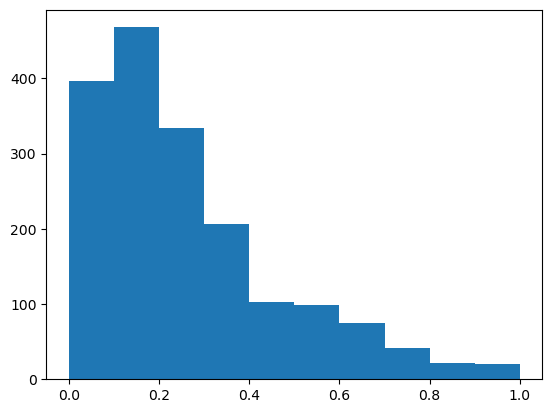

In [293]:
plt.hist(qf_212, bins=np.linspace(0, 1, num=11))

In [66]:
mir_cat = Table.read('/orange/adamginsburg/jwst/cloudc/catalogs/miri_good_matches_crowdsource_nsky1_photometry_tables_merged.fits')

In [67]:
mir_cat[:2]

skycoord_ref,skycoord_ref_filtername,sep_f410m,id_f410m,skycoord_f410m,x_f410m,y_f410m,flux_f410m,passno_f410m,dx_f410m,dy_f410m,dflux_f410m,qf_f410m,rchi2_f410m,fracflux_f410m,fluxlbs_f410m,dfluxlbs_f410m,fwhm_f410m,spread_model_f410m,dspread_model_f410m,fluxiso_f410m,xiso_f410m,yiso_f410m,flags_f410m,sky_f410m,mask_f410m,flux_jy_f410m,eflux_jy_f410m,mag_ab_f410m,emag_ab_f410m,near_saturated_f410m_f410m,replaced_saturated_f410m,sep_f212n,id_f212n,skycoord_f212n,x_f212n,y_f212n,flux_f212n,passno_f212n,dx_f212n,dy_f212n,dflux_f212n,qf_f212n,rchi2_f212n,fracflux_f212n,fluxlbs_f212n,dfluxlbs_f212n,fwhm_f212n,spread_model_f212n,dspread_model_f212n,fluxiso_f212n,xiso_f212n,yiso_f212n,flags_f212n,sky_f212n,mask_f212n,flux_jy_f212n,eflux_jy_f212n,mag_ab_f212n,emag_ab_f212n,near_saturated_f212n_f212n,replaced_saturated_f212n,sep_f466n,id_f466n,skycoord_f466n,x_f466n,y_f466n,flux_f466n,passno_f466n,dx_f466n,dy_f466n,dflux_f466n,qf_f466n,rchi2_f466n,fracflux_f466n,fluxlbs_f466n,dfluxlbs_f466n,fwhm_f466n,spread_model_f466n,dspread_model_f466n,fluxiso_f466n,xiso_f466n,yiso_f466n,flags_f466n,sky_f466n,mask_f466n,flux_jy_f466n,eflux_jy_f466n,mag_ab_f466n,emag_ab_f466n,near_saturated_f466n_f466n,replaced_saturated_f466n,sep_f405n,id_f405n,skycoord_f405n,x_f405n,y_f405n,flux_f405n,passno_f405n,dx_f405n,dy_f405n,dflux_f405n,qf_f405n,rchi2_f405n,fracflux_f405n,fluxlbs_f405n,dfluxlbs_f405n,fwhm_f405n,spread_model_f405n,dspread_model_f405n,fluxiso_f405n,xiso_f405n,yiso_f405n,flags_f405n,sky_f405n,mask_f405n,flux_jy_f405n,eflux_jy_f405n,mag_ab_f405n,emag_ab_f405n,near_saturated_f405n_f405n,replaced_saturated_f405n,sep_f187n,id_f187n,skycoord_f187n,x_f187n,y_f187n,flux_f187n,passno_f187n,dx_f187n,dy_f187n,dflux_f187n,qf_f187n,rchi2_f187n,fracflux_f187n,fluxlbs_f187n,dfluxlbs_f187n,fwhm_f187n,spread_model_f187n,dspread_model_f187n,fluxiso_f187n,xiso_f187n,yiso_f187n,flags_f187n,sky_f187n,mask_f187n,flux_jy_f187n,eflux_jy_f187n,mag_ab_f187n,emag_ab_f187n,near_saturated_f187n_f187n,replaced_saturated_f187n,sep_f182m,id_f182m,skycoord_f182m,x_f182m,y_f182m,flux_f182m,passno_f182m,dx_f182m,dy_f182m,dflux_f182m,qf_f182m,rchi2_f182m,fracflux_f182m,fluxlbs_f182m,dfluxlbs_f182m,fwhm_f182m,spread_model_f182m,dspread_model_f182m,fluxiso_f182m,xiso_f182m,yiso_f182m,flags_f182m,sky_f182m,mask_f182m,flux_jy_f182m,eflux_jy_f182m,mag_ab_f182m,emag_ab_f182m,near_saturated_f182m_f182m,replaced_saturated_f182m,flux_jy_410m405,mag_ab_410m405,flux_jy_405m410,mag_ab_405m410,flux_jy_182m187,mag_ab_182m187,flux_jy_187m182,mag_ab_187m182,skycoord_f2550w,x_f2550w,y_f2550w,flux_f2550w,passno_f2550w,dx_f2550w,dy_f2550w,dflux_f2550w,qf_f2550w,rchi2_f2550w,fracflux_f2550w,fluxlbs_f2550w,dfluxlbs_f2550w,fwhm_f2550w,spread_model_f2550w,dspread_model_f2550w,fluxiso_f2550w,xiso_f2550w,yiso_f2550w,flags_f2550w,sky_f2550w,mask_f2550w,real_miri_f2550w,flux_jy_f2550w,eflux_jy_f2550w,mag_ab_f2550w,emag_ab_f2550w,sep_f2550w_f2550w,id_f2550w_f2550w,good_match,xcentroid,ycentroid
"deg,deg",,deg,,"deg,deg",,,,,,,,,,,,,,,,,,,,,,Jy,Jy,,,,,deg,,"deg,deg",,,,,,,,,,,,,,,,,,,,,,Jy,Jy,,,,,deg,,"deg,deg",,,,,,,,,,,,,,,,,,,,,,Jy,Jy,,,,,deg,,"deg,deg",,,,,,,,,,,,,,,,,,,,,,Jy,Jy,,,,,deg,,"deg,deg",,,,,,,,,,,,,,,,,,,,,,Jy,Jy,,,,,deg,,"deg,deg",,,,,,,,,,,,,,,,,,,,,,Jy,Jy,,,,,Jy,Jy,Jy,Jy,Jy,Jy,Jy,Jy,"deg,deg",,,,,,,,,,,,,,,,,,,,,,,Jy,Jy,,,deg,,,,
SkyCoord,bytes5,float64,int64,SkyCoord,float64,float64,float32,float64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float64,float64,int32,float32,bool,float32,float32,float32,float32,bool,bool,float64,int64,SkyCoord,float64,float64,float32,float64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float64,float64,int32,float32,bool,float32,float32,float32,float32,bool,bool,float64,int64,SkyCoord,float64,float64,float32,float64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float64,float64,int32,float32,bool,float32,floa

In [68]:
mir_use = mir_cat[mir_cat['good_match']]
mir_use_crds = mir_use['skycoord_f2550w']
mir_use_in = mir_use[reg_cloudc.contains(mir_use_crds, wcs=ww)]

In [69]:
color_mir = mir_use_in['mag_ab_f187n'] - mir_use_in['mag_ab_f405n']

2024-05-29 13:38:27,126 - stpipe - WARNING - Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0, 0.5, '[F187N] - [F405N]')

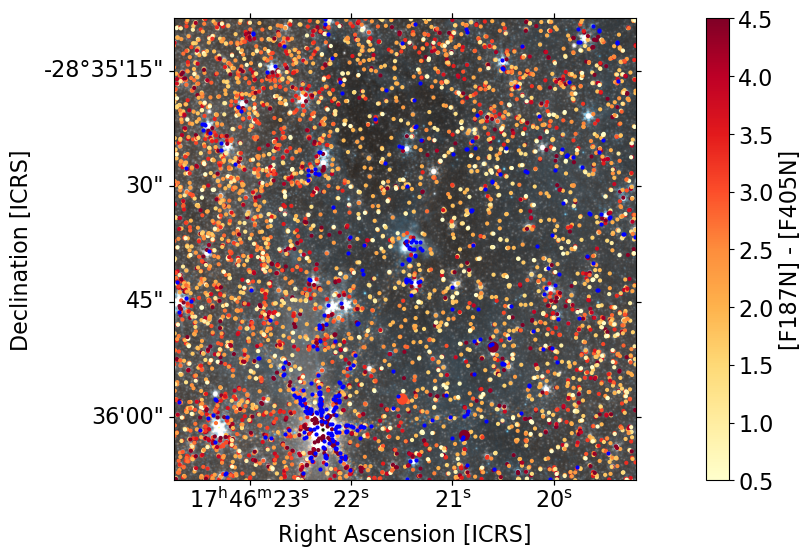

In [70]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(rgb, vmin=0, vmax=50)
im = ax.scatter(crds_in.ra, crds_in.dec, c=color, cmap='YlOrRd', transform=ax.get_transform('world'), s=4, vmin=0.5, vmax=4.5)
ax.scatter(mir_use_in['skycoord_f2550w'].ra, mir_use_in['skycoord_f2550w'].dec, c=color_mir, cmap='YlOrRd', transform=ax.get_transform('world'), s=50, vmin=0.5, vmax=4.5)
ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=4)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('[F187N] - [F405N]', rotation=90)

In [71]:
color_x_mir =  mir_use_in['mag_ab_f182m'] - mir_use_in['mag_ab_f212n']
color_y1_mir = mir_use_in['mag_ab_f212n'] - mir_use_in['mag_ab_f410m']
color_y2_mir = mir_use_in['mag_ab_f410m'] - mir_use_in['mag_ab_f466n']

(-5.0, 4.0)

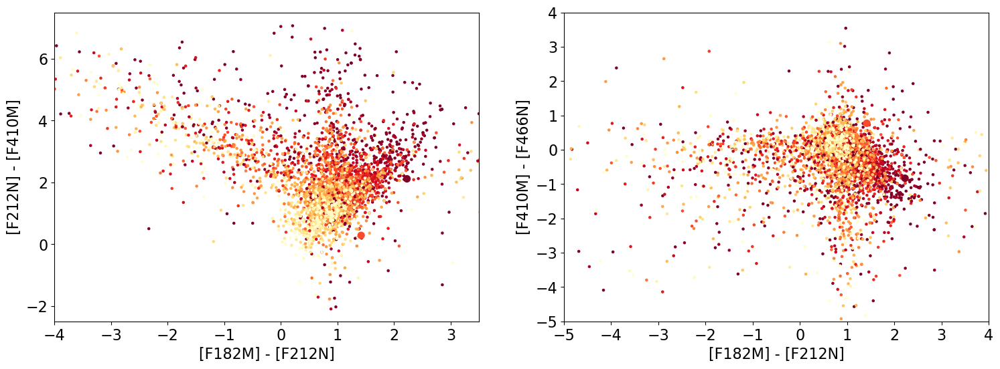

In [72]:
fig = plt.figure(figsize=(18, 6))

ax1 = plt.subplot(121)
im = ax1.scatter(color_x, color_y1, c=color, vmin=0.5, vmax=4.5, cmap='YlOrRd', s=5)
ax1.scatter(color_x_mir, color_y1_mir, c=color_mir, vmin=0.5, vmax=4.5, cmap='YlOrRd', s=50)
ax1.set_xlabel('[F182M] - [F212N]')
ax1.set_ylabel('[F212N] - [F410M]')
ax1.set_xlim(left=-4, right=3.5)
ax1.set_ylim(bottom=-2.5, top=7.5)

ax2 = plt.subplot(122)
ax2.scatter(color_x, color_y2, c=color, vmin=0.5, vmax=4.5, cmap='YlOrRd', s=5)
ax2.scatter(color_x_mir, color_y2_mir, c=color_mir, vmin=0.5, vmax=4.5, cmap='YlOrRd', s=50)
ax2.set_xlabel('[F182M] - [F212N]')
ax2.set_ylabel('[F410M] - [F466N]')
ax2.set_xlim(left=-5, right=4)
ax2.set_ylim(bottom=-5, top=4)

#cbar = fig.colorbar(im)

In [73]:
color_y3_mir = mir_use_in['mag_ab_f405n'] - mir_use_in['mag_ab_f410m']
color_y4_mir = mir_use_in['mag_ab_f187n'] - mir_use_in['mag_ab_f182m']
color_y5_mir = mir_use_in['mag_ab_f212n'] - mir_use_in['mag_ab_f182m']

Text(0, 0.5, '[F212N] - [F182M]')

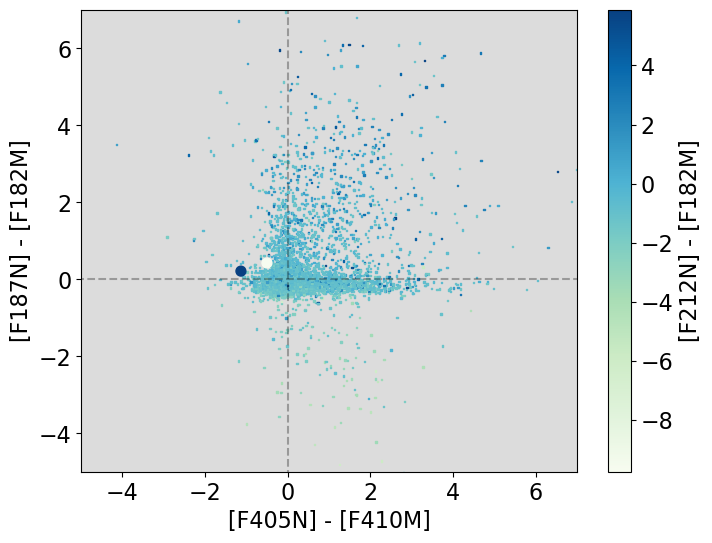

In [74]:
fig = plt.figure(figsize=(8, 6))

ax2 = plt.subplot(111)
im = ax2.scatter(color_y3, color_y4, c=color_y5, marker=',', s=1, cmap='GnBu')#, vmin=-5, vmax=4)
ax2.scatter(color_y3_mir, color_y4_mir, c=color_y5_mir,cmap='GnBu', s=50)#, vmin=0.5, vmax=4.5, )
ax2.set_xlabel('[F405N] - [F410M]')
ax2.set_ylabel('[F187N] - [F182M]')
ax2.set_xlim(left=-5, right=7)
ax2.set_ylim(bottom=-5, top=7)
ax2.set_facecolor('gainsboro')
plt.hlines(0, xmin=-10, xmax=10, color='k', linestyle='--', alpha=0.3)
plt.vlines(0, ymin=-10, ymax=10, color='k', linestyle='--', alpha=0.3)

cbar = fig.colorbar(im)
cbar.ax.set_ylabel('[F212N] - [F182M]', rotation=90)

2024-05-29 13:38:31,504 - stpipe - WARNING - Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0, 0.5, '[F212N] - [F182M]')

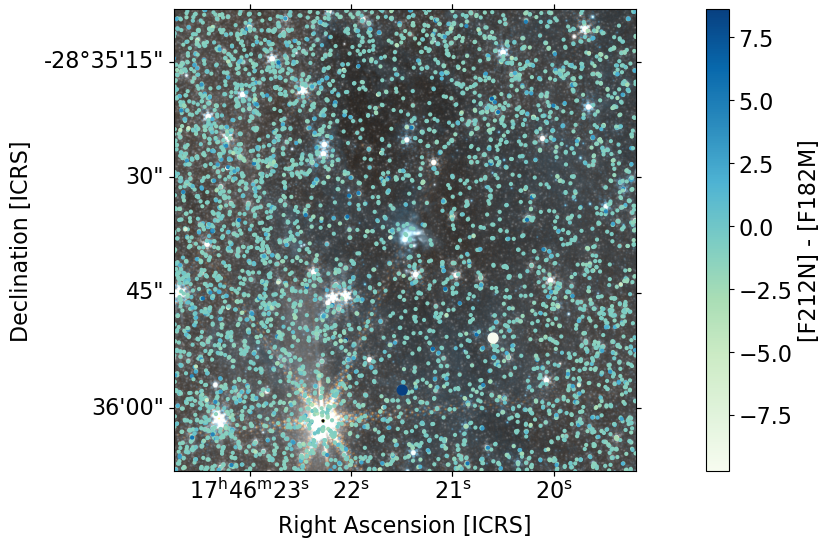

In [75]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(rgb, vmin=0, vmax=50)
im = ax.scatter(crds_in.ra, crds_in.dec, c=color_y5, cmap='GnBu', transform=ax.get_transform('world'), s=4)#, vmin=0.5, vmax=4.5)
ax.scatter(mir_use_in['skycoord_f2550w'].ra, mir_use_in['skycoord_f2550w'].dec, c=color_y5_mir, cmap='GnBu', transform=ax.get_transform('world'), s=50)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=4)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('[F212N] - [F182M]', rotation=90)

2024-05-29 13:38:33,450 - stpipe - WARNING - Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0, 0.5, '[F187N] - [F182M]')

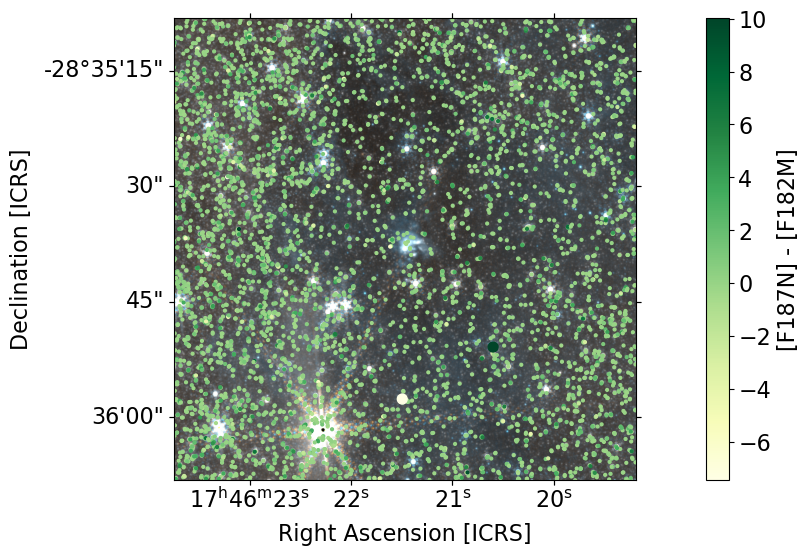

In [76]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(rgb, vmin=0, vmax=50)
im = ax.scatter(crds_in.ra, crds_in.dec, c=color_y4, cmap='YlGn', transform=ax.get_transform('world'), s=4)#, vmin=0.5, vmax=4.5)
ax.scatter(mir_use_in['skycoord_f2550w'].ra, mir_use_in['skycoord_f2550w'].dec, c=color_y4_mir, cmap='YlGn', transform=ax.get_transform('world'), s=50)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=4)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('[F187N] - [F182M]', rotation=90)

2024-05-29 13:38:35,529 - stpipe - WARNING - Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0, 0.5, '[F405N] - [F410M]')

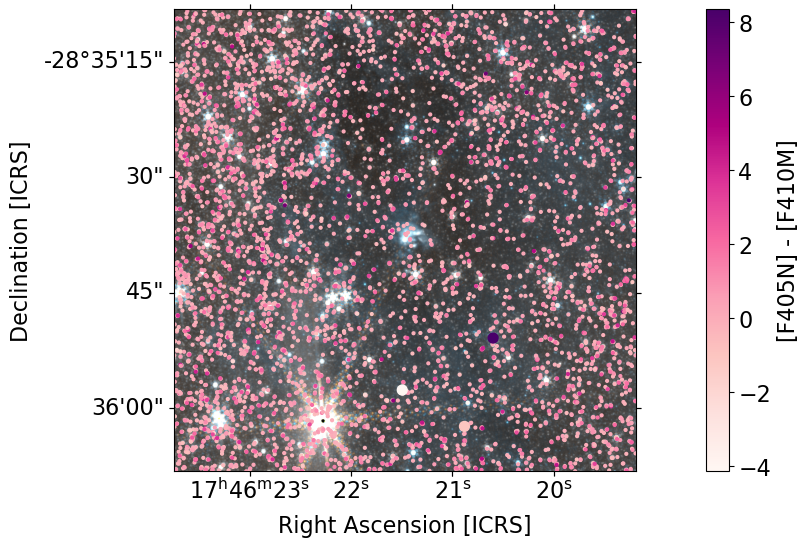

In [77]:
fig = plt.figure(figsize=(18, 6))
ax = plt.subplot(111, projection=ww)
ax.imshow(rgb, vmin=0, vmax=50)
im = ax.scatter(crds_in.ra, crds_in.dec, c=color_y3, cmap='RdPu', transform=ax.get_transform('world'), s=4)#, vmin=0.5, vmax=4.5)
ax.scatter(mir_use_in['skycoord_f2550w'].ra, mir_use_in['skycoord_f2550w'].dec, c=color_y3_mir, cmap='RdPu', transform=ax.get_transform('world'), s=50)
#ax.scatter(crds_other_in.ra, crds_other_in.dec, color='blue', transform=ax.get_transform('world'), s=4)
ax.set_ylabel('Declination [ICRS]', fontsize=16)
ax.set_xlabel('Right Ascension [ICRS]', fontsize=16)
cbar = fig.colorbar(im)
cbar.ax.set_ylabel('[F405N] - [F410M]', rotation=90)